## AIM: Train multiclass classification ML models for predicting the psychiatric diagnosis based on EEG features

SVC, RanFor & GradientBoostingClassifier for predicting psychiatric diagnosis with statistical features of the power per frequency band per channel group. Statistical features are calculated with EC data, EO data and a with the ratio between EC divided by EO. Compared to older versions of this notebook (found in 'old_notebooks' dir); gender will not be used as a feature, the data will be subsampled by diagnosis to rebalance the dataset, only Boruta selected features will be used, no PCA, and additional models including the functional connectivity features will be trained.

see 'paired_t_test_ml_models.ipynb' in 'background_notebooks' for paired t-tests of the F1-scores between the models

In [1]:
import numpy as np
import pandas as pd
import sklearn
import pickle
import mne
import os
import matplotlib.pyplot as plt
from mne.time_frequency import tfr_multitaper

%matplotlib inline

# prevent extensive logging
mne.set_log_level('WARNING')

In [3]:
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
print(n_estimators)

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


## Loading in feature data

#### Boruta-selected stat features

In [53]:
df_stat_features = pd.read_pickle(r'D:\Documents\RU\Master_Neurobiology\Internship_jaar_2\Project\TD-BRAIN\TD-BRAIN_extracted_features\df_selected_stat_features.pkl')
df_stat_features = df_stat_features.dropna(subset=['diagnosis'])
df_stat_features.sample(7)

,ID,epoch,diagnosis,EC_l_frontal_delta_mean,EC_l_frontal_delta_median,EC_l_frontal_theta_std,EC_l_frontal_theta_mean,EC_l_frontal_theta_median,EC_l_frontal_alpha_std,EC_l_frontal_alpha_mean,...,ratio_r_posterior_delta_median,ratio_r_posterior_theta_mean,ratio_r_posterior_theta_median,ratio_r_posterior_alpha_median,ratio_r_posterior_beta_std,ratio_r_posterior_beta_mean,ratio_r_posterior_beta_median,ratio_r_posterior_gamma_std,ratio_r_posterior_gamma_mean,ratio_r_posterior_gamma_median
1033,sub-87974617,2,HEALTHY,0.080235,0.080235,0.026510,0.050808,0.050808,0.042196,0.057723,...,0.948775,1.409172,1.116314,2.567485,0.759664,1.596157,1.500552,2.384066,4.313200,3.780857
3561,sub-88036037,10,MDD,0.065578,0.065578,0.039584,0.063006,0.063006,0.056948,0.058747,...,1.151952,2.110581,1.359519,1.876518,0.736830,1.412771,1.242670,0.635119,1.090242,1.018115
1177,sub-87976641,2,HEALTHY,0.025359,0.025359,0.013024,0.028769,0.028769,0.036861,0.115682,...,0.756193,1.827671,1.040788,1.691827,2.679403,2.409575,1.455334,0.446449,0.820580,0.714390
4604,sub-88046393,9,ADHD,0.116160,0.116160,0.033865,0.061689,0.061689,0.022402,0.030333,...,1.059119,1.698569,1.090568,1.254494,1.069349,1.167240,0.820287,0.280231,0.679251,0.622706
4896,sub-88049089,1,MDD,0.100443,0.100443,0.032417,0.053228,0.053228,0.028421,0.039799,...,0.378845,0.620709,0.453641,3.054118,3.427501,3.361812,2.102124,0.358025,0.639631,0.546123
1153,sub-87976461,2,HEALTHY,0.068654,0.068654,0.027946,0.049260,0.049260,0.058066,0.071890,...,0.552502,1.366649,0.959264,2.997222,2.144250,2.582421,1.972682,0.210210,0.523234,0.493365
7485,sub-88073521,10,ADHD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [54]:
df_stat_features['diagnosis'].value_counts()

diagnosis
SMC        540
HEALTHY    540
MDD        540
ADHD       540
OCD        540
Name: count, dtype: int64

In [55]:
# create 3 feature sets [EC, EO, ratio] with column ['ID', 'age', 'gender', 'diagnosis', 'epoch']
df_stat_features_ec = df_stat_features[df_stat_features.columns[~(df_stat_features.columns.str.startswith('EO') | df_stat_features.columns.str.startswith('ratio'))]]
df_stat_features_eo = df_stat_features[df_stat_features.columns[~(df_stat_features.columns.str.startswith('EC') | df_stat_features.columns.str.startswith('ratio'))]]
df_stat_features_ratio = df_stat_features[df_stat_features.columns[~(df_stat_features.columns.str.startswith('EC') | df_stat_features.columns.str.startswith('EO'))]]

#### Boruta-selected stat features + connectivity features

In [56]:
df_stat_conn_features = pd.read_pickle(r'D:\Documents\RU\Master_Neurobiology\Internship_jaar_2\Project\TD-BRAIN\TD-BRAIN_extracted_features\df_selected_stat_conn_features.pkl')
df_stat_conn_features = df_stat_conn_features.dropna(subset=['diagnosis'])
df_stat_conn_features.sample(7)

,ID,epoch,diagnosis,EC_l_frontal_delta_std,EC_l_frontal_delta_mean,EC_l_frontal_delta_median,EC_l_frontal_theta_std,EC_l_frontal_theta_mean,EC_l_frontal_theta_median,EC_l_frontal_alpha_std,...,ratio_gamma_m_central-r_central,ratio_gamma_m_central-l_posterior,ratio_gamma_m_central-m_posterior,ratio_gamma_m_central-r_posterior,ratio_gamma_r_central-l_posterior,ratio_gamma_r_central-m_posterior,ratio_gamma_r_central-r_posterior,ratio_gamma_l_posterior-m_posterior,ratio_gamma_l_posterior-r_posterior,ratio_gamma_m_posterior-r_posterior
880,sub-88002789,5,MDD,0.057110,0.054148,0.054148,0.021858,0.042202,0.042202,0.041683,...,1.035486,1.054207,1.051789,1.052531,1.067137,1.074698,1.063946,1.058359,1.057695,1.050474
821,sub-87980869,6,HEALTHY,0.057168,0.092868,0.092868,0.022481,0.051411,0.051411,0.020835,...,1.005415,0.971778,0.975037,0.973457,1.003923,1.010010,0.999518,0.981596,0.974017,0.983520
178,sub-87967869,11,SMC,0.033582,0.052401,0.052401,0.040247,0.065630,0.065630,0.053221,...,0.980891,0.943131,0.962052,0.964329,0.941357,0.950171,0.974905,0.947136,0.934257,0.940835
2208,sub-88064253,1,OCD,0.033121,0.047071,0.047071,0.020682,0.037494,0.037494,0.043723,...,1.003092,0.976476,0.983078,0.992656,0.983743,1.000854,0.998590,0.973473,0.979445,0.991436
1034,sub-88020017,3,MDD,0.068623,0.084077,0.084077,0.030246,0.068736,0.068736,0.028575,...,0.945749,1.046770,0.992981,0.989280,1.013831,0.975895,0.983482,0.995027,1.014589,0.989186
1746,sub-88052825,7,ADHD,0.111212,0.119751,0.119751,0.030002,0.047709,0.047709,0.017278,...,0.968801,1.036389,0.990710,0.975472,1.083005,1.036749,1.002149,1.035698,1.043741,1.004901
433,sub-87970389,2,SMC,0.059729,0.093495,0.093495,0.025925,0.054616,0.054616,0.024894,...,0.959493,0.944341,0.912216,0.896334,0.941894,0.930044,0.923753,0.957451,0.913060,0.921215


In [57]:
df_stat_conn_features['diagnosis'].value_counts()

diagnosis
SMC        540
HEALTHY    540
MDD        540
ADHD       540
OCD        540
Name: count, dtype: int64

In [58]:
# create 3 feature sets [EC, EO, ratio] with column ['ID', 'age', 'gender', 'diagnosis', 'epoch']
df_stat_conn_features_ec = df_stat_conn_features[df_stat_conn_features.columns[~(df_stat_conn_features.columns.str.startswith('EO') | df_stat_conn_features.columns.str.startswith('ratio'))]]
df_stat_conn_features_eo = df_stat_conn_features[df_stat_conn_features.columns[~(df_stat_conn_features.columns.str.startswith('EC') | df_stat_conn_features.columns.str.startswith('ratio'))]]
df_stat_conn_features_ratio = df_stat_conn_features[df_stat_conn_features.columns[~(df_stat_conn_features.columns.str.startswith('EC') | df_stat_conn_features.columns.str.startswith('EO'))]]

In [59]:
print(df_stat_conn_features_ratio.shape)
print(df_stat_conn_features_ec.shape)
print(df_stat_conn_features_eo.shape)

(2700, 185)
(2700, 322)
(2700, 304)


In [60]:
df_stat_conn_features_ec.isna().sum()

ID                                   0
epoch                                0
diagnosis                            0
EC_l_frontal_delta_std              12
EC_l_frontal_delta_mean             12
                                    ..
EC_gamma_r_central-m_posterior      12
EC_gamma_r_central-r_posterior      12
EC_gamma_l_posterior-m_posterior    12
EC_gamma_l_posterior-r_posterior    12
EC_gamma_m_posterior-r_posterior    12
Length: 322, dtype: int64

In [64]:
# obtain indices for the first outer split for the ML models, to use as validation set for the GCNs for model comparison (which is the same as long as shuffle=False)
from sklearn.model_selection import StratifiedGroupKFold
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False)
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False)

split_indices = {}
for df_feature_set, feature_set in zip([df_stat_conn_features_ratio, df_stat_conn_features_ec, df_stat_conn_features_eo], ['ratio', 'EC', 'EO']):
    numeric_cols = [num_col for num_col in df_feature_set.columns if feature_set in num_col]
    df_feature_set = df_feature_set.dropna(subset=numeric_cols)
    groups = df_feature_set['ID'].tolist()
    X = df_feature_set[numeric_cols]
    Y = df_feature_set['diagnosis']
    # split test set from data
    baseline_rest_idxs, baseline_test_idxs = cv_outer.split(X, Y, groups).__next__()
    X_rest, Y_rest = X.iloc[baseline_rest_idxs], Y.iloc[baseline_rest_idxs]
    groups_array = np.array(groups)
    groups_rest = groups_array[baseline_rest_idxs]

    # split train and val set
    baseline_train_idxs, baseline_val_idxs = cv_inner.split(X_rest, Y_rest, groups_rest).__next__()
    groups_test = groups_array[baseline_test_idxs]
    groups_train = groups_rest[baseline_train_idxs]
    groups_val = groups_rest[baseline_val_idxs]
    unique_groups_test = np.unique(groups_test)
    unique_groups_train = np.unique(groups_train)
    unique_groups_val = np.unique(groups_val)

    split_indices[feature_set] = (unique_groups_train, unique_groups_val, unique_groups_test)
    

# save the split indices for GCN model comparison
with open('data_split_groups.pkl', 'wb') as f:
    pickle.dump(split_indices, f)

# Training models (SVC, RF, GBC):
Each model is tuned & trained seperately with the selected ratio, EC, EO features from the two feature sets: 1) statistical TFR feature (baseline), 2) statistical TFR + connectivity features (extended). All models are tuned, trained & evaluated using nested cv (inner=3, outer=5), with SVC using GridSearchCV for tuning, and RF & GBC using RandomizedSearchCV for tuning.

# 1. statistical TFR features (baseline):

## SVC

#### ratio feature set

In [11]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_features_ratio[numeric_cols]
Y = df_stat_features_ratio['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols),
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
gridsearch_fit = gridsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {gridsearch_fit.best_params_}')
print(f'Best f1-score: {gridsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
svm_test_score = cross_val_score(gridsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', svm_test_score)
print('Mean SVM test score:', np.mean(svm_test_score))
print('STD SVM test score:', np.std(svm_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best parameters: {'rbf_svm__estimator__C': 1, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}
Best f1-score: 0.2241445897795141


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

SVM test scores: [0.26175223 0.23213146 0.22483193 0.20023039 0.24957504]
Mean SVM test score: 0.23370421363900512
STD SVM test score: 0.021167248631063763


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   27.5s finished


In [12]:
with open("stat_svm_ratio.txt", "w") as output:
    output.write(str(np.mean(svm_test_score)))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


{'C': 1, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    8.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.2500463214673637

classification report:
               precision    recall  f1-score   support

        ADHD       0.35      0.37      0.36       540
     HEALTHY       0.24      0.24      0.24       540
         MDD       0.20      0.18      0.19       540
         OCD       0.23      0.20      0.21       540
         SMC       0.23      0.28      0.25       540

    accuracy                           0.25      2700
   macro avg       0.25      0.25      0.25      2700
weighted avg       0.25      0.25      0.25      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    8.4s finished


Micro-averaged One-vs-Rest ROC AUC score:
0.55


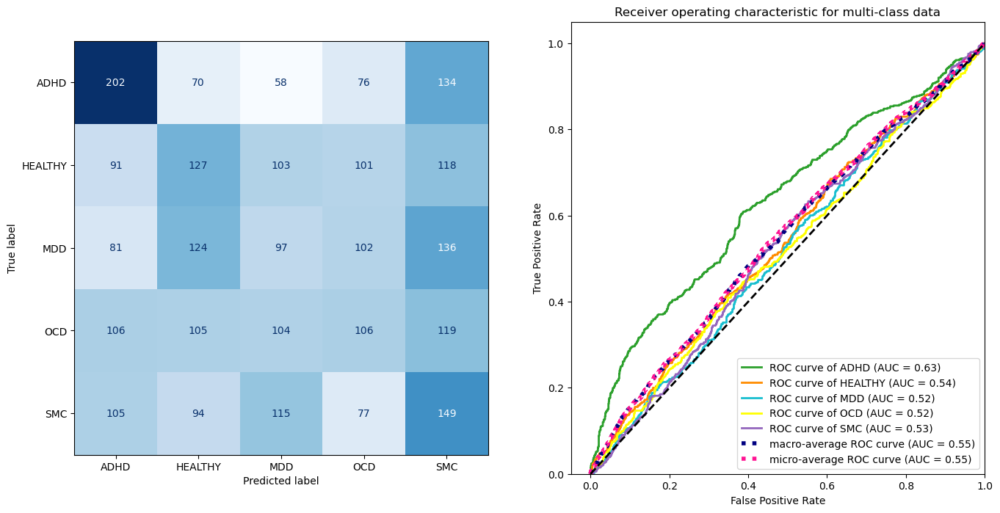

In [13]:
# final evaluation on best tuned model pipeline
best_params = {}
for hyperparameter in gridsearch.best_params_: # get the best hyperparameters from nested CV
    key = hyperparameter[20:]
    best_params[key] = gridsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

from sklearn.metrics import roc_auc_score

micro_roc_auc_ovr = roc_auc_score(
    Y_one_hot,
    Y_score,
    multi_class="ovr",
    average="micro",
)

print(f"Micro-averaged One-vs-Rest ROC AUC score:\n{micro_roc_auc_ovr:.2f}")

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 66), X_test.shape = (672, 66), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

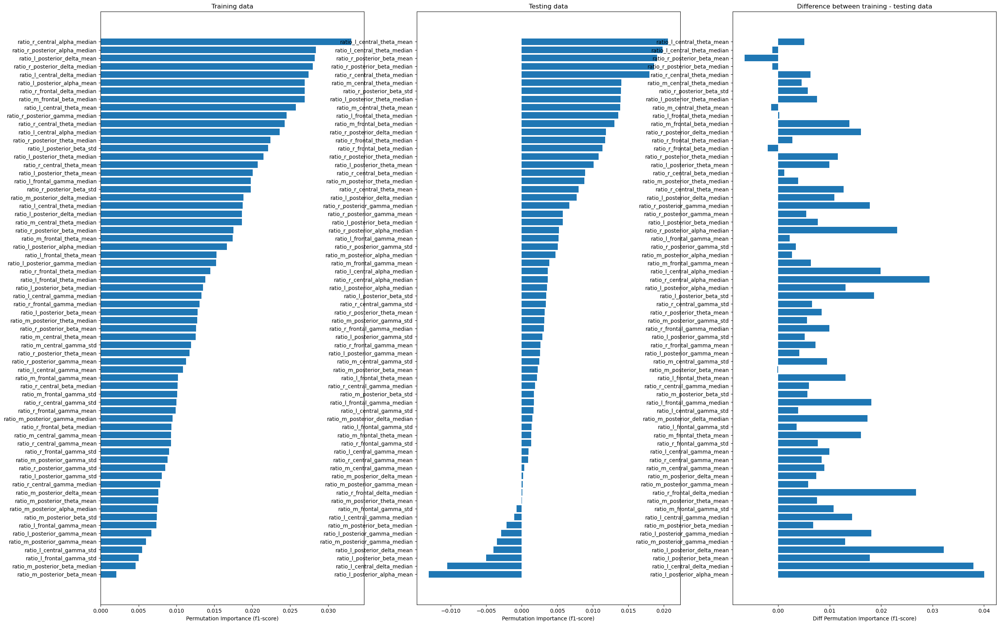

In [14]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EC feature set

In [15]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ec.columns if 'EC' in num_col]
 
X = df_stat_features_ec[numeric_cols]
Y = df_stat_features_ec['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
gridsearch_fit = gridsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {gridsearch_fit.best_params_}')
print(f'Best f1-score: {gridsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
svm_test_score = cross_val_score(gridsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', svm_test_score)
print('Mean SVM test score:', np.mean(svm_test_score))
print('STD SVM test score:', np.std(svm_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best parameters: {'rbf_svm__estimator__C': 1, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}
Best f1-score: 0.2631155768002362


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

SVM test scores: [0.26799392 0.28289344 0.20875805 0.27411337 0.30310368]
Mean SVM test score: 0.26737249081726544
STD SVM test score: 0.0316199195824491


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   43.8s finished


In [16]:
with open("stat_svm_ec.txt", "w") as output:
    output.write(str(np.mean(svm_test_score)))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


{'C': 1, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.272533781958042

classification report:
               precision    recall  f1-score   support

        ADHD       0.40      0.31      0.35       540
     HEALTHY       0.33      0.26      0.29       540
         MDD       0.23      0.16      0.19       540
         OCD       0.18      0.13      0.15       540
         SMC       0.28      0.57      0.38       540

    accuracy                           0.29      2700
   macro avg       0.29      0.29      0.27      2700
weighted avg       0.29      0.29      0.27      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.3s finished


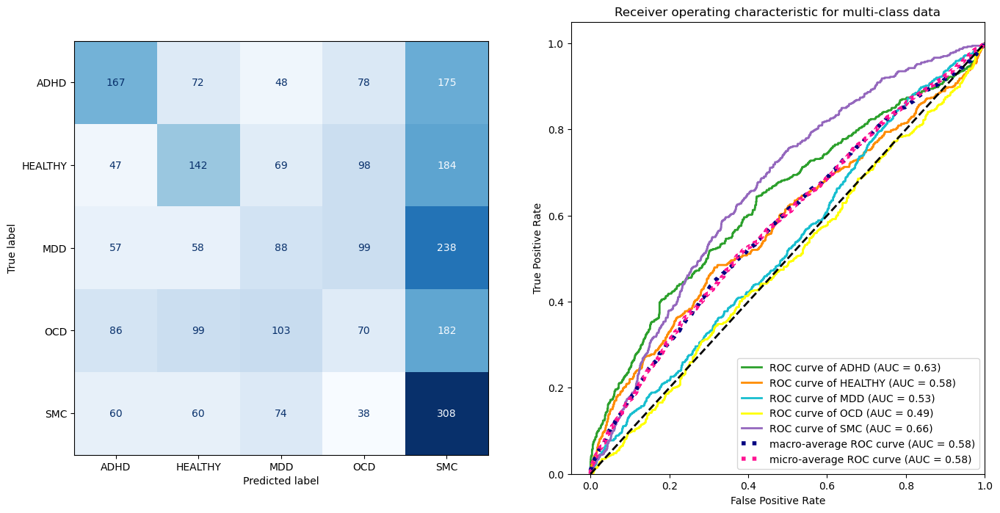

In [17]:
# final pipeline
best_params = {}
for hyperparameter in gridsearch.best_params_:
    key = hyperparameter[20:]
    best_params[key] = gridsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 147), X_test.shape = (672, 147), Y_train.shape = (2028,), Y_test.shape = (672,)
Fitting 3 folds for each of 20 candidates, totalling 60 fits


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Text(0.5, 1.0, 'Difference between training - testing data')

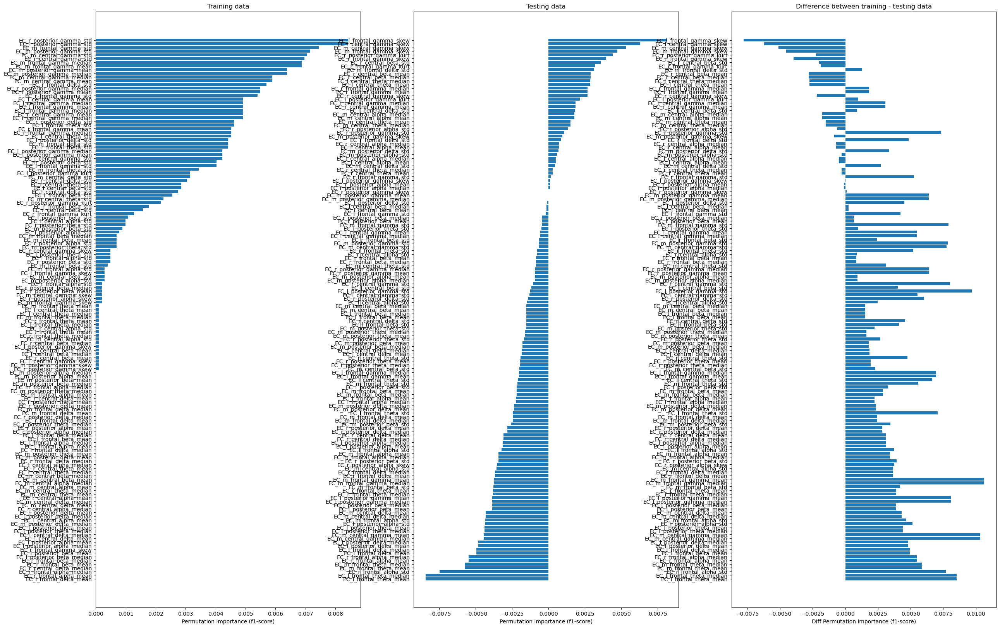

In [18]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EO feature set

In [19]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_eo.columns if 'EO' in num_col]
 
X = df_stat_features_eo[numeric_cols]
Y = df_stat_features_eo['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
gridsearch_fit = gridsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {gridsearch_fit.best_params_}')
print(f'Best f1-score: {gridsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
svm_test_score = cross_val_score(gridsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', svm_test_score)
print('Mean SVM test score:', np.mean(svm_test_score))
print('STD SVM test score:', np.std(svm_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best parameters: {'rbf_svm__estimator__C': 1, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}
Best f1-score: 0.30824910262058935


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

SVM test scores: [0.38871635 0.3708784  0.26908511 0.27943377 0.32383937]
Mean SVM test score: 0.3263906006311722
STD SVM test score: 0.047663479454831875


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   41.9s finished


In [20]:
with open("stat_svm_eo.txt", "w") as output:
    output.write(str(np.mean(svm_test_score)))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


{'C': 1, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.32734557308107715

classification report:
               precision    recall  f1-score   support

        ADHD       0.50      0.39      0.44       540
     HEALTHY       0.35      0.28      0.31       540
         MDD       0.23      0.15      0.18       540
         OCD       0.32      0.21      0.25       540
         SMC       0.34      0.71      0.46       540

    accuracy                           0.35      2700
   macro avg       0.35      0.35      0.33      2700
weighted avg       0.35      0.35      0.33      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.1s finished


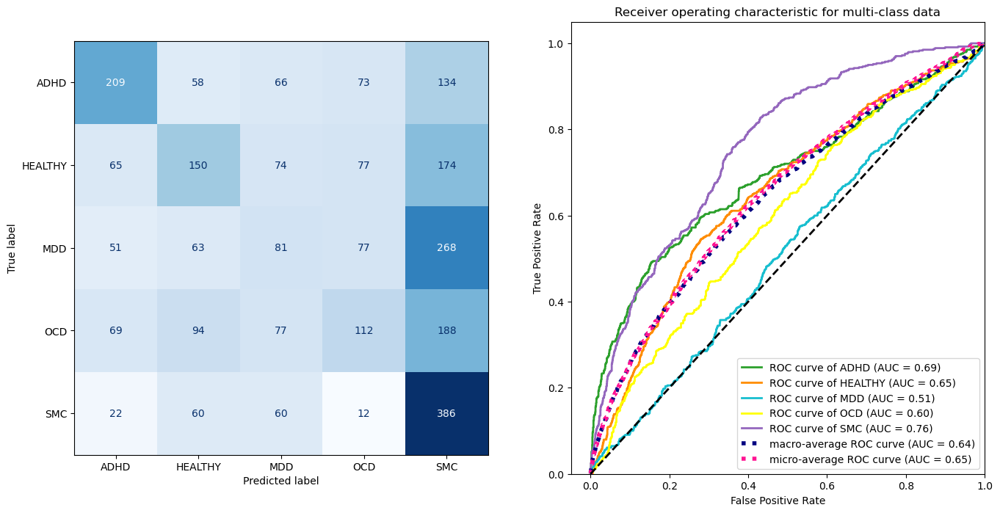

In [21]:
# final pipeline
best_params = {}
for hyperparameter in gridsearch.best_params_:
    key = hyperparameter[20:]
    best_params[key] = gridsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 135), X_test.shape = (672, 135), Y_train.shape = (2028,), Y_test.shape = (672,)
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Text(0.5, 1.0, 'Difference between training - testing data')

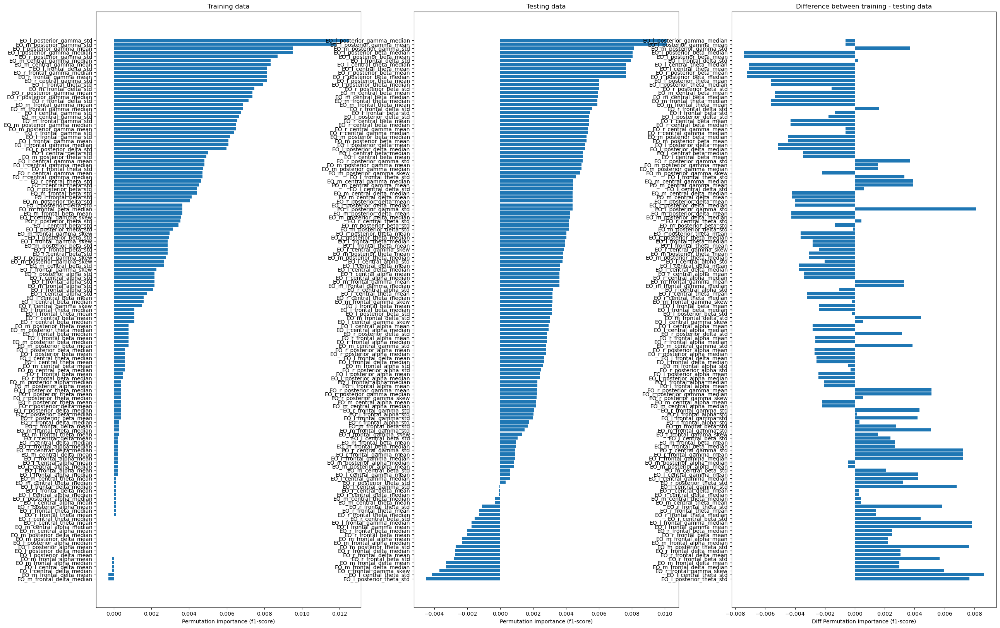

In [22]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

## Random Forest

#### ratio feature set

In [23]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_features_ratio[numeric_cols]
Y = df_stat_features_ratio['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
rf_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', rf_test_score)
print('Mean RF test score:', np.mean(rf_test_score))
print('STD RF test score:', np.std(rf_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best parameters: {'RF__n_estimators': 600, 'RF__min_samples_split': 5, 'RF__min_samples_leaf': 1, 'RF__max_features': 'log2', 'RF__max_depth': 90, 'RF__bootstrap': True}
Best f1-score: 0.2683805453910893


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.33002713 0.33008437 0.21584666 0.21690673 0.28994353]
Mean RF test score: 0.27656168305539
STD RF test score: 0.05127832734131806


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 27.7min finished


In [24]:
with open("stat_rf_ratio.txt", "w") as output:
    output.write(str(np.mean(rf_test_score)))

{'n_estimators': 600, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'log2', 'max_depth': 90, 'bootstrap': True}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    8.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.2784421620973886

classification report:
               precision    recall  f1-score   support

        ADHD       0.40      0.45      0.43       540
     HEALTHY       0.27      0.31      0.29       540
         MDD       0.19      0.16      0.17       540
         OCD       0.25      0.25      0.25       540
         SMC       0.28      0.24      0.26       540

    accuracy                           0.28      2700
   macro avg       0.28      0.28      0.28      2700
weighted avg       0.28      0.28      0.28      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    7.8s finished


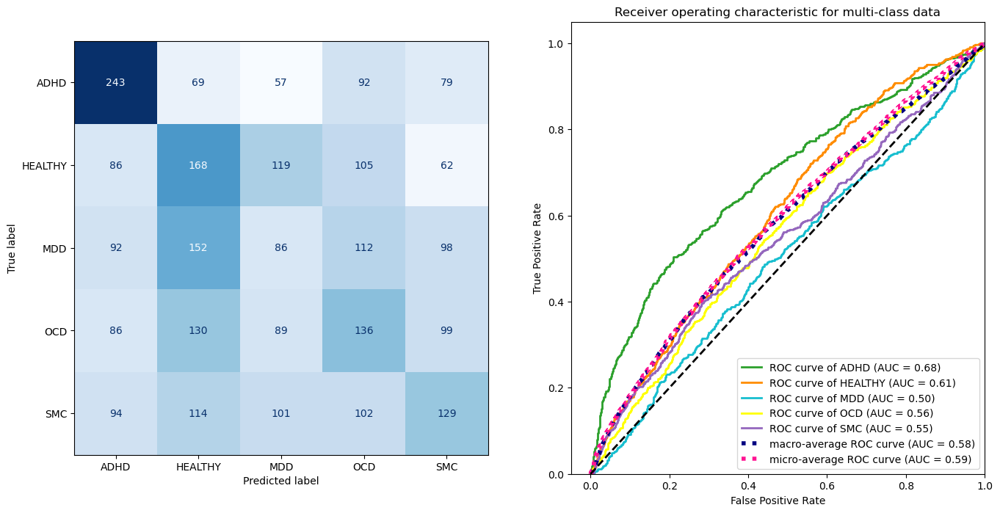

In [25]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[4:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 66), X_test.shape = (672, 66), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

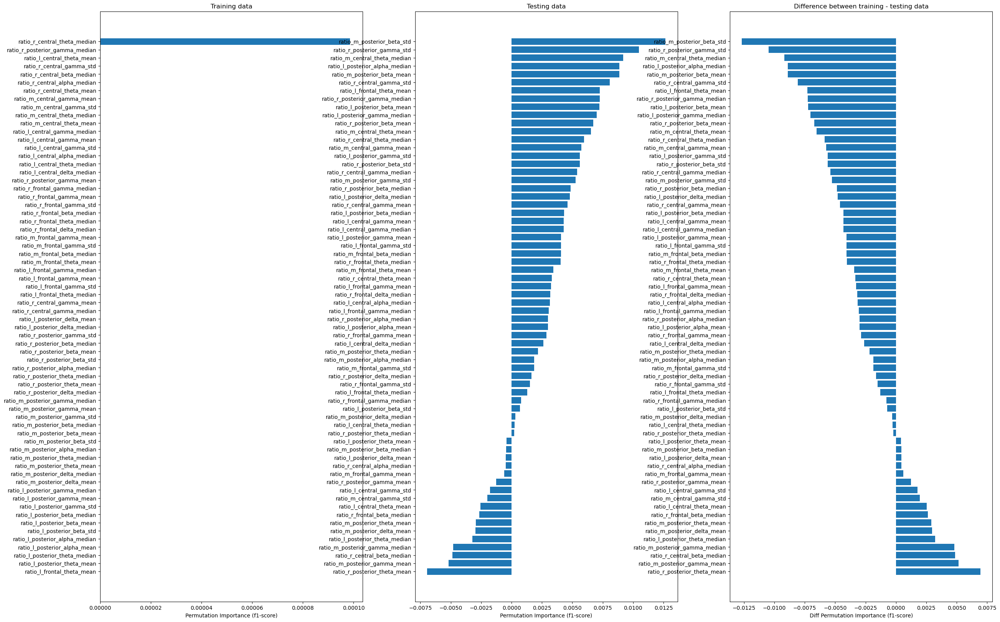

In [26]:
# using permutation_importance()
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EC feature set

In [27]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ec.columns if 'EC' in num_col]
 
X = df_stat_features_ec[numeric_cols]
Y = df_stat_features_ec['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
rf_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', rf_test_score)
print('Mean RF test score:', np.mean(rf_test_score))
print('STD RF test score:', np.std(rf_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters: {'RF__n_estimators': 1600, 'RF__min_samples_split': 5, 'RF__min_samples_leaf': 4, 'RF__max_features': 'log2', 'RF__max_depth': 10, 'RF__bootstrap': True}
Best f1-score: 0.35869527487431974


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value en

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.3894122  0.36765405 0.34168394 0.35075057 0.35664429]
Mean RF test score: 0.3612290117474382
STD RF test score: 0.016421939793714948


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 29.6min finished


In [28]:
with open("stat_rf_ec.txt", "w") as output:
    output.write(str(np.mean(rf_test_score)))

{'n_estimators': 1600, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 'log2', 'max_depth': 10, 'bootstrap': True}
Fitting 3 folds for each of 100 candidates, totalling 300 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   17.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.3749028943529699

classification report:
               precision    recall  f1-score   support

        ADHD       0.48      0.45      0.46       540
     HEALTHY       0.41      0.44      0.43       540
         MDD       0.30      0.25      0.27       540
         OCD       0.30      0.32      0.31       540
         SMC       0.39      0.42      0.40       540

    accuracy                           0.38      2700
   macro avg       0.38      0.38      0.37      2700
weighted avg       0.38      0.38      0.37      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   16.5s finished


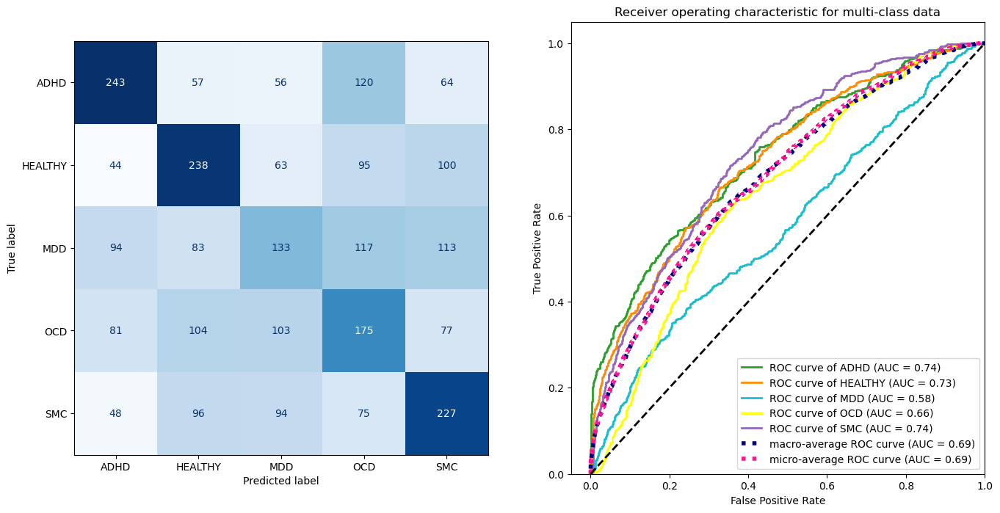

In [29]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[4:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 147), X_test.shape = (672, 147), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

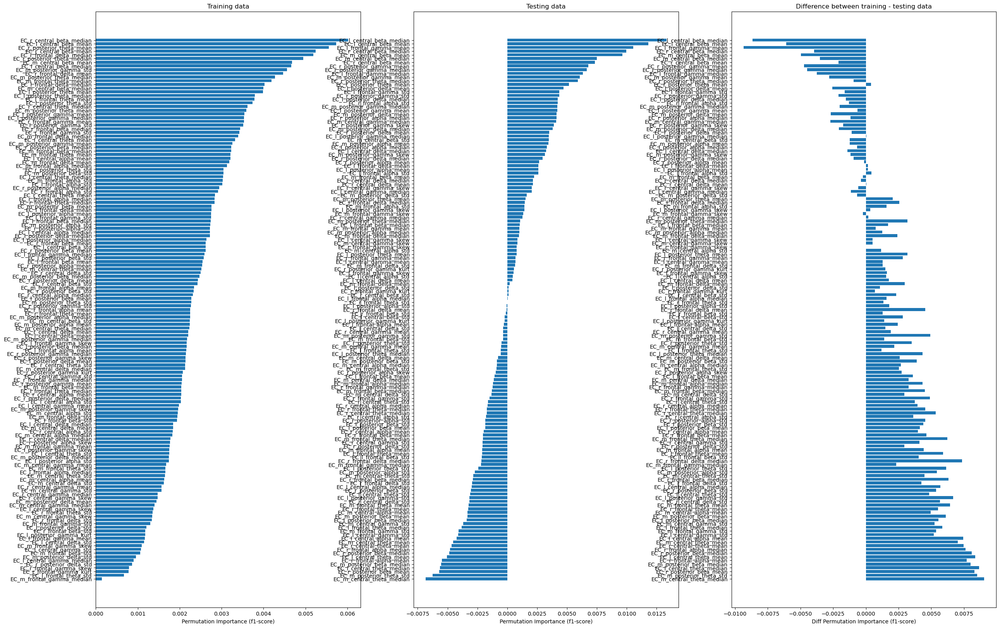

In [30]:
# using permutation_importance()
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EO feature set

In [31]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_eo.columns if 'EO' in num_col]

X = df_stat_features_eo[numeric_cols]
Y = df_stat_features_eo['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
rf_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', rf_test_score)
print('Mean RF test score:', np.mean(rf_test_score))
print('STD RF test score:', np.std(rf_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters: {'RF__n_estimators': 200, 'RF__min_samples_split': 10, 'RF__min_samples_leaf': 2, 'RF__max_features': 'sqrt', 'RF__max_depth': 70, 'RF__bootstrap': False}
Best f1-score: 0.3865014924027548


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value en

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.36136045 0.42853737 0.29483077 0.27441349 0.46709614]
Mean RF test score: 0.36524764593391323
STD RF test score: 0.07430100323242057


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 29.6min finished


In [32]:
with open("stat_rf_eo.txt", "w") as output:
    output.write(str(np.mean(rf_test_score)))

{'n_estimators': 200, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'max_depth': 70, 'bootstrap': False}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    6.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.3615729163078474

classification report:
               precision    recall  f1-score   support

        ADHD       0.48      0.48      0.48       540
     HEALTHY       0.35      0.39      0.37       540
         MDD       0.23      0.20      0.21       540
         OCD       0.35      0.31      0.33       540
         SMC       0.40      0.44      0.42       540

    accuracy                           0.36      2700
   macro avg       0.36      0.36      0.36      2700
weighted avg       0.36      0.36      0.36      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    6.2s finished


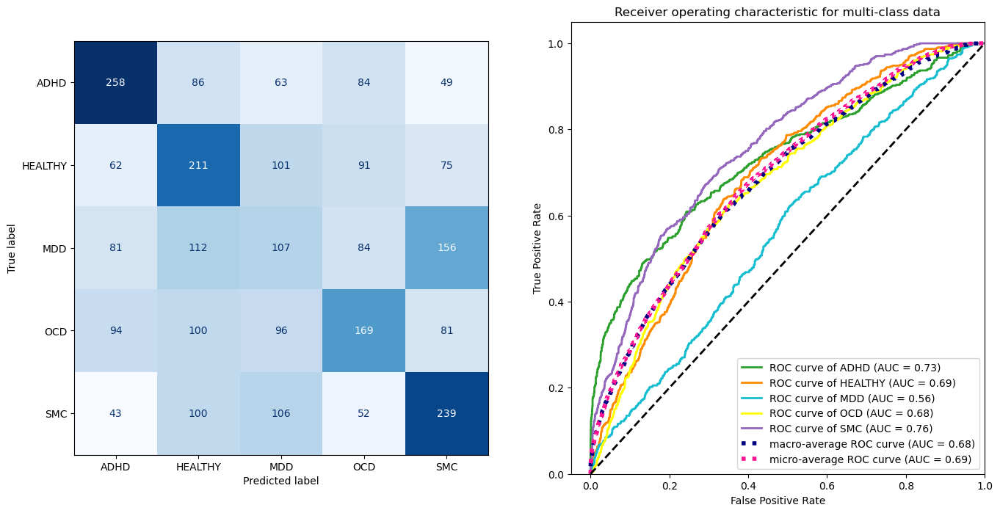

In [33]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[4:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 135), X_test.shape = (672, 135), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

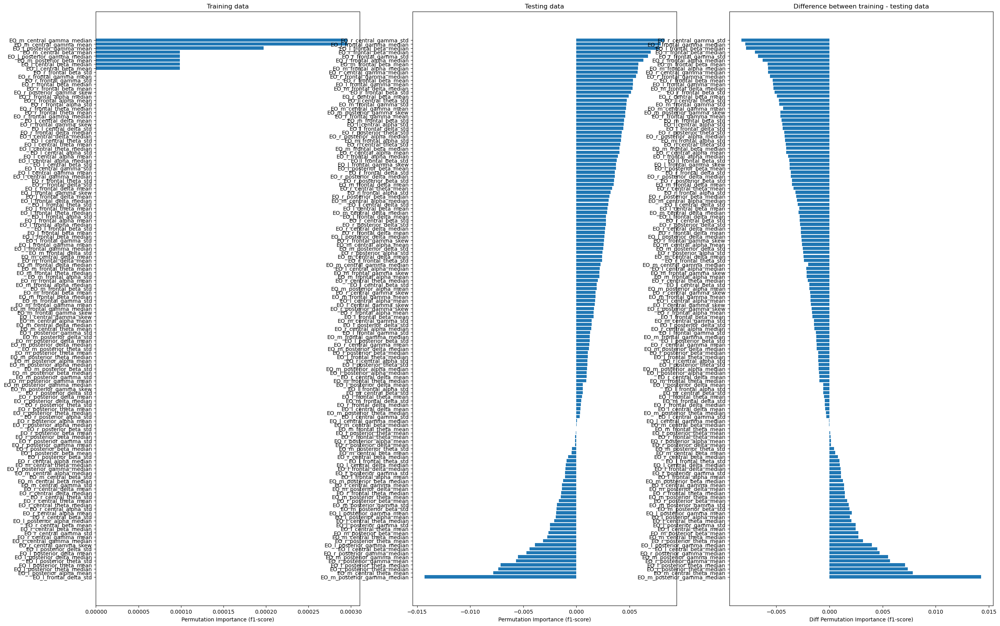

In [34]:
# using permutation_importance()
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

## GradientBoostingClassifier

#### ratio feature set

In [35]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_features_ratio[numeric_cols]
Y = df_stat_features_ratio['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
gbc_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', gbc_test_score)
print('Mean GBC test score:', np.mean(gbc_test_score))
print('STD GBC test score:', np.std(gbc_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters: {'gbc__subsample': 0.5, 'gbc__n_estimators': 100, 'gbc__min_samples_split': 5, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.004160287265988609, 'gbc__criterion': 'friedman_mse'}
Best f1-score: 0.2707199351349572


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value en

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.3150968  0.31612608 0.2151449  0.21779565 0.26421315]
Mean GBC test score: 0.265675316725333
STD GBC test score: 0.04435242101796211


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 96.6min finished


In [36]:
with open("stat_gbc_ratio.txt", "w") as output:
    output.write(str(np.mean(gbc_test_score)))

{'subsample': 0.5, 'n_estimators': 100, 'min_samples_split': 5, 'loss': 'log_loss', 'learning_rate': 0.004160287265988609, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.0s finished


f1_score: 0.27055475157444775

classification report:
               precision    recall  f1-score   support

        ADHD       0.37      0.41      0.39       540
     HEALTHY       0.29      0.27      0.28       540
         MDD       0.21      0.11      0.15       540
         OCD       0.24      0.37      0.29       540
         SMC       0.27      0.24      0.25       540

    accuracy                           0.28      2700
   macro avg       0.27      0.28      0.27      2700
weighted avg       0.27      0.28      0.27      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   12.5s finished


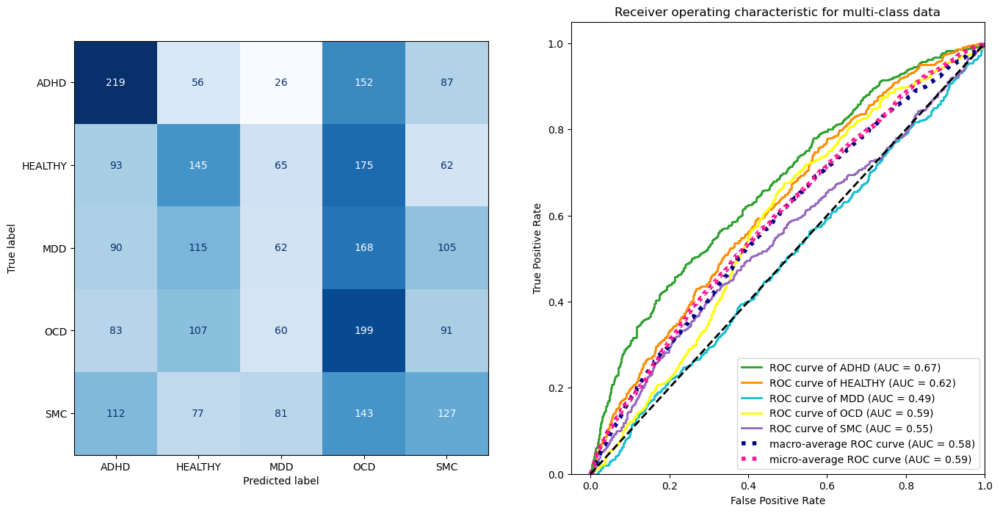

In [37]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[5:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 66), X_test.shape = (672, 66), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

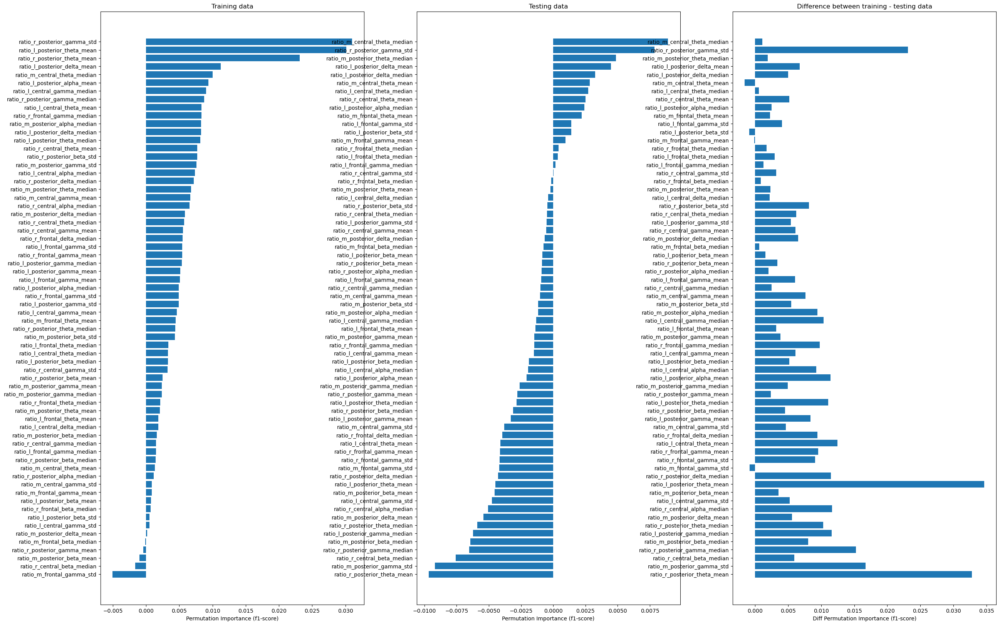

In [38]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EC feature set

In [39]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_ec.columns if 'EC' in num_col]
 
X = df_stat_features_ec[numeric_cols]
Y = df_stat_features_ec['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
gbc_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', gbc_test_score)
print('Mean GBC test score:', np.mean(gbc_test_score))
print('STD GBC test score:', np.std(gbc_test_score))

# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters: {'gbc__subsample': 0.5, 'gbc__n_estimators': 900, 'gbc__min_samples_split': 10, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.004265276572478257, 'gbc__criterion': 'friedman_mse'}
Best f1-score: 0.3768340458846091


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value en

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.40261872 0.35873796 0.32537353 0.37315005 0.38889539]
Mean GBC test score: 0.3697551290503771
STD GBC test score: 0.026642053236724497


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 124.5min finished


In [40]:
with open("stat_gbc_ec.txt", "w") as output:
    output.write(str(np.mean(gbc_test_score)))

{'subsample': 0.5, 'n_estimators': 900, 'min_samples_split': 10, 'loss': 'log_loss', 'learning_rate': 0.004265276572478257, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  3.9min finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.3888641090959376

classification report:
               precision    recall  f1-score   support

        ADHD       0.46      0.47      0.46       540
     HEALTHY       0.42      0.43      0.42       540
         MDD       0.31      0.26      0.28       540
         OCD       0.33      0.33      0.33       540
         SMC       0.42      0.47      0.45       540

    accuracy                           0.39      2700
   macro avg       0.39      0.39      0.39      2700
weighted avg       0.39      0.39      0.39      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  3.9min finished


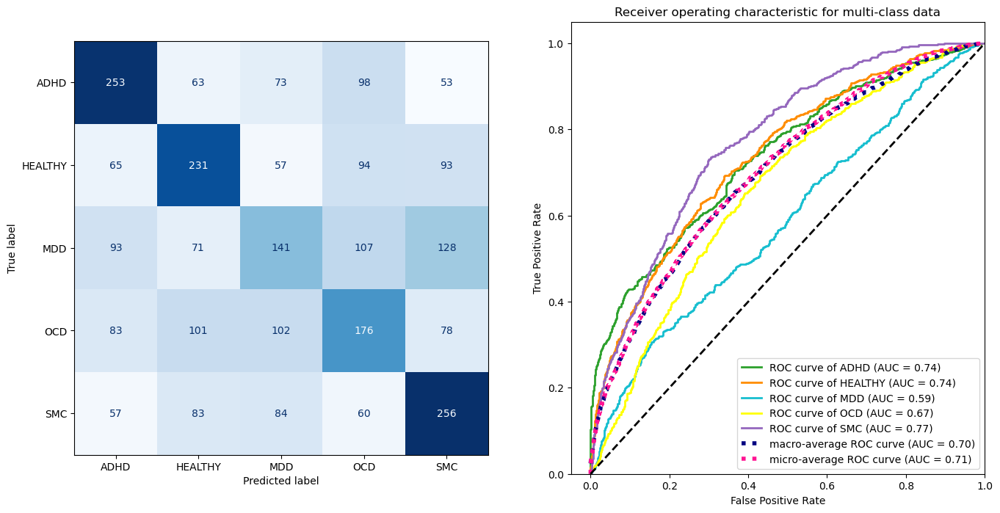

In [41]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[5:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 147), X_test.shape = (672, 147), Y_train.shape = (2028,), Y_test.shape = (672,)
Fitting 3 folds for each of 100 candidates, totalling 300 fits


Text(0.5, 1.0, 'Difference between training - testing data')

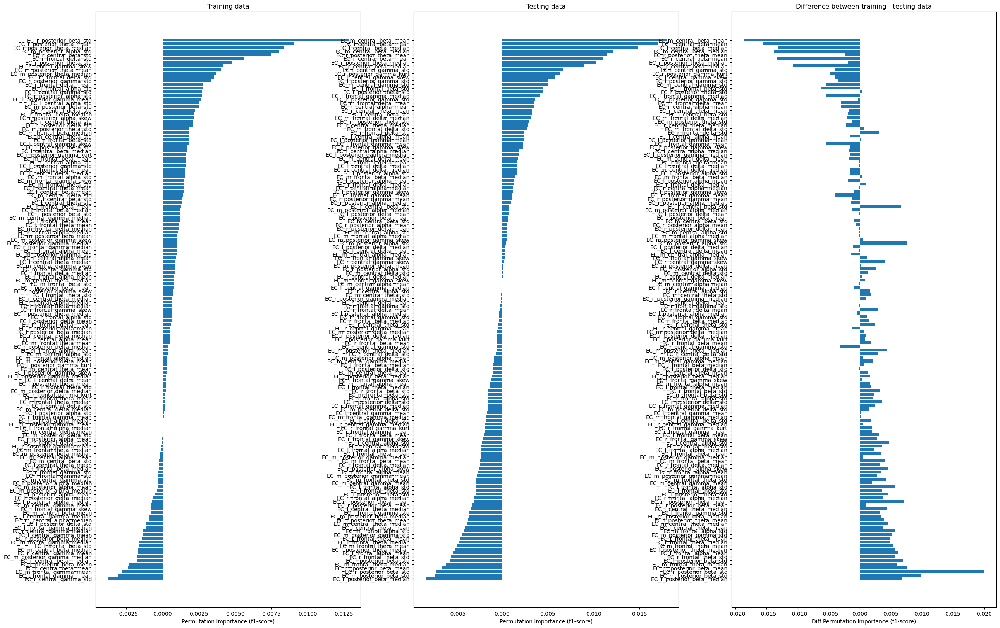

In [42]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EO feature set

In [43]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_features_eo.columns if 'EO' in num_col]
 
X = df_stat_features_eo[numeric_cols]
Y = df_stat_features_eo['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
gbc_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', gbc_test_score)
print('Mean GBC test score:', np.mean(gbc_test_score))
print('STD GBC test score:', np.std(gbc_test_score))

# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters: {'gbc__subsample': 0.75, 'gbc__n_estimators': 600, 'gbc__min_samples_split': 2, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.021887977236583155, 'gbc__criterion': 'friedman_mse'}
Best f1-score: 0.3973266958813411


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2


Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.41311023 0.42111301 0.31530776 0.30754339 0.45706852]
Mean GBC test score: 0.3828285837012676
STD GBC test score: 0.060201603815355206


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 121.4min finished


In [44]:
with open("stat_gbc_eo.txt", "w") as output:
    output.write(str(np.mean(gbc_test_score)))

{'subsample': 0.75, 'n_estimators': 600, 'min_samples_split': 2, 'loss': 'log_loss', 'learning_rate': 0.021887977236583155, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  3.7min finished


f1_score: 0.38908040609661176

classification report:
               precision    recall  f1-score   support

        ADHD       0.49      0.48      0.49       540
     HEALTHY       0.38      0.40      0.39       540
         MDD       0.29      0.26      0.28       540
         OCD       0.36      0.35      0.35       540
         SMC       0.42      0.46      0.44       540

    accuracy                           0.39      2700
   macro avg       0.39      0.39      0.39      2700
weighted avg       0.39      0.39      0.39      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  3.7min finished


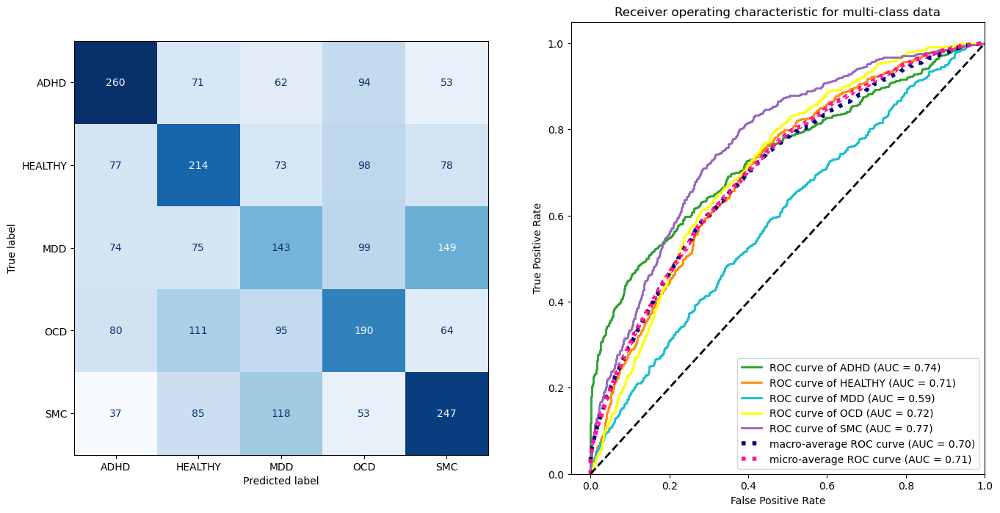

In [45]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[5:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 135), X_test.shape = (672, 135), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

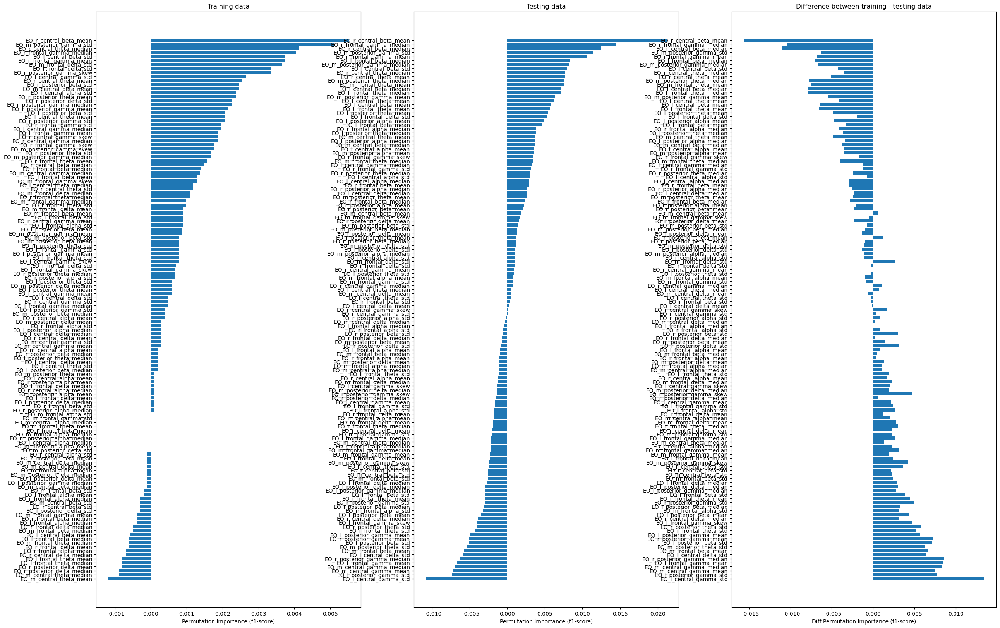

In [46]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

# 2. statistical + connectivity features

## SVC

#### ratio feature set

In [47]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_conn_features_ratio[numeric_cols]
Y = df_stat_conn_features_ratio['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols),
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
gridsearch_fit = gridsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {gridsearch_fit.best_params_}')
print(f'Best f1-score: {gridsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
svm_test_score = cross_val_score(gridsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', svm_test_score)
print('Mean SVM test score:', np.mean(svm_test_score))
print('STD SVM test score:', np.std(svm_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best parameters: {'rbf_svm__estimator__C': 1, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}
Best f1-score: 0.19653923915363214


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 20 candidates, totalling 60 fits
SVM test scores: [0.20175346 0.21660407 0.17397969 0.15018683 0.16253967]
Mean SVM test score: 0.1810127431249416
STD SVM test score: 0.02464903561884662


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   49.1s finished


In [48]:
with open("stat_conn_svm_ratio.txt", "w") as output:
    output.write(str(np.mean(svm_test_score)))

{'C': 1, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.20047603643262982

classification report:
               precision    recall  f1-score   support

        ADHD       0.25      0.06      0.09       540
     HEALTHY       0.21      0.45      0.28       540
         MDD       0.20      0.11      0.14       540
         OCD       0.35      0.17      0.23       540
         SMC       0.21      0.33      0.26       540

    accuracy                           0.22      2700
   macro avg       0.24      0.22      0.20      2700
weighted avg       0.24      0.22      0.20      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.6s finished


Micro-averaged One-vs-Rest ROC AUC score:
0.54


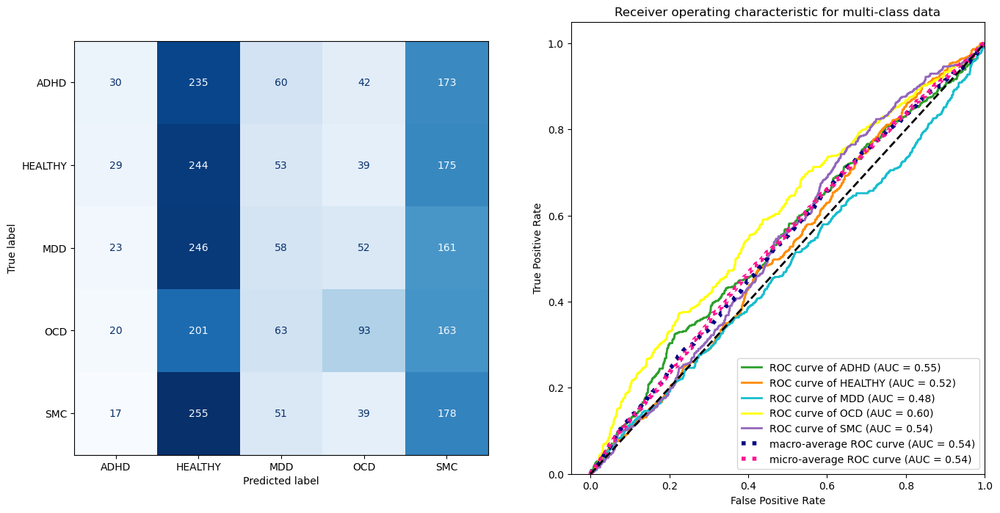

In [49]:
# final pipeline
best_params = {}
for hyperparameter in gridsearch.best_params_:
    key = hyperparameter[20:]
    best_params[key] = gridsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

from sklearn.metrics import roc_auc_score

micro_roc_auc_ovr = roc_auc_score(
    Y_one_hot,
    Y_score,
    multi_class="ovr",
    average="micro",
)

print(f"Micro-averaged One-vs-Rest ROC AUC score:\n{micro_roc_auc_ovr:.2f}")

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 182), X_test.shape = (672, 182), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

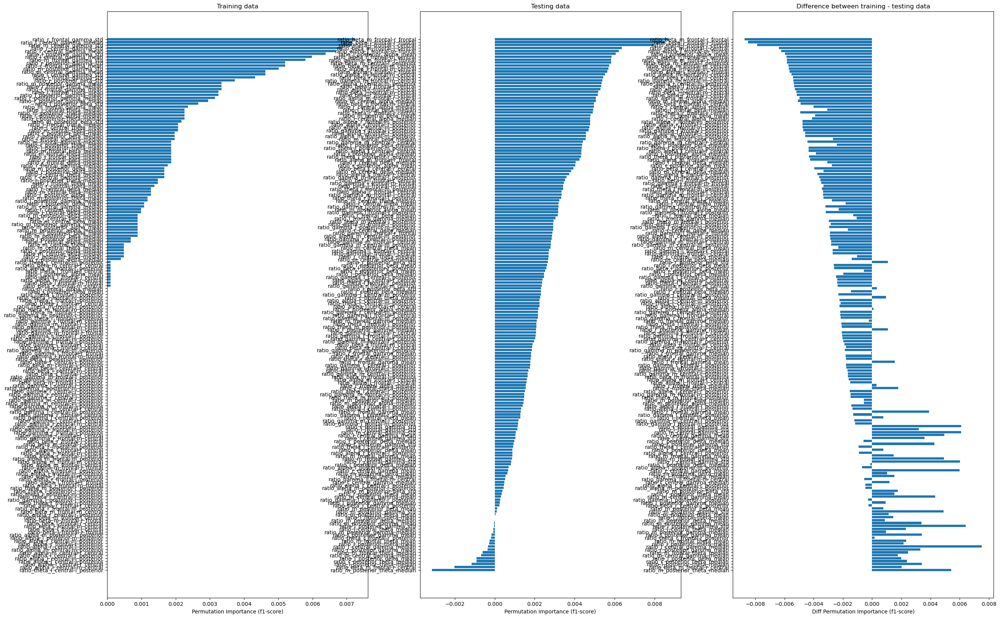

In [50]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EC feature set

In [51]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ec.columns if 'EC' in num_col]
 
X = df_stat_conn_features_ec[numeric_cols]
Y = df_stat_conn_features_ec['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
gridsearch_fit = gridsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {gridsearch_fit.best_params_}')
print(f'Best f1-score: {gridsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
svm_test_score = cross_val_score(gridsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', svm_test_score)
print('Mean SVM test score:', np.mean(svm_test_score))
print('STD SVM test score:', np.std(svm_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best parameters: {'rbf_svm__estimator__C': 0.01, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}
Best f1-score: 0.0964186345340114


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
SVM test scores: [0.12152663 0.06563467 0.08199706 0.09934066 0.08892857]
Mean SVM test score: 0.09148551941004968
STD SVM test score: 0.01859573326442503


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.2min finished


In [52]:
with open("stat_conn_svm_ec.txt", "w") as output:
    output.write(str(np.mean(svm_test_score)))

{'C': 0.01, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}
Fitting 3 folds for each of 20 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   19.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.12200376488069938

classification report:
               precision    recall  f1-score   support

        ADHD       0.57      0.02      0.04       540
     HEALTHY       0.20      0.20      0.20       540
         MDD       0.53      0.01      0.03       540
         OCD       0.31      0.01      0.01       540
         SMC       0.20      0.80      0.33       540

    accuracy                           0.21      2700
   macro avg       0.36      0.21      0.12      2700
weighted avg       0.36      0.21      0.12      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   19.0s finished


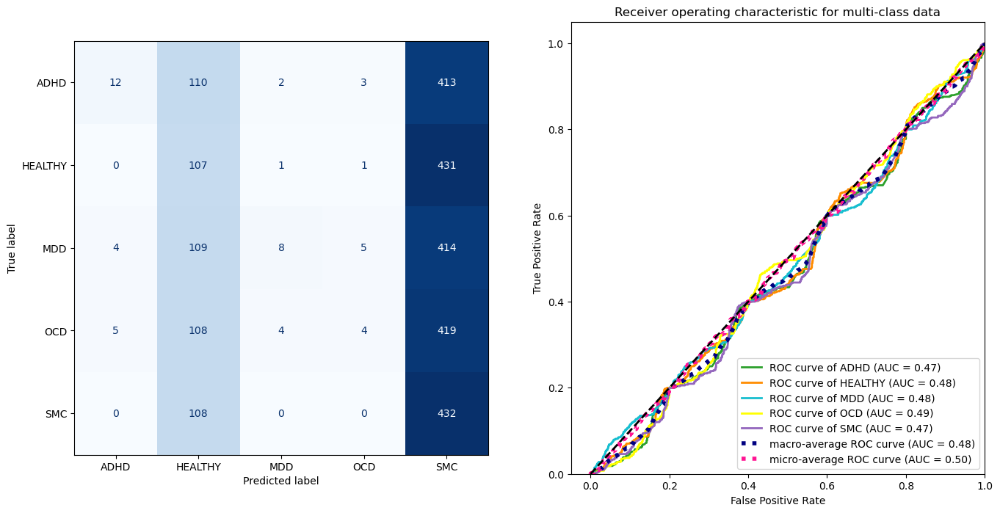

In [53]:
# final pipeline
best_params = {}
for hyperparameter in gridsearch.best_params_:
    key = hyperparameter[20:]
    best_params[key] = gridsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 319), X_test.shape = (672, 319), Y_train.shape = (2028,), Y_test.shape = (672,)
Fitting 3 folds for each of 20 candidates, totalling 60 fits


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Text(0.5, 1.0, 'Difference between training - testing data')

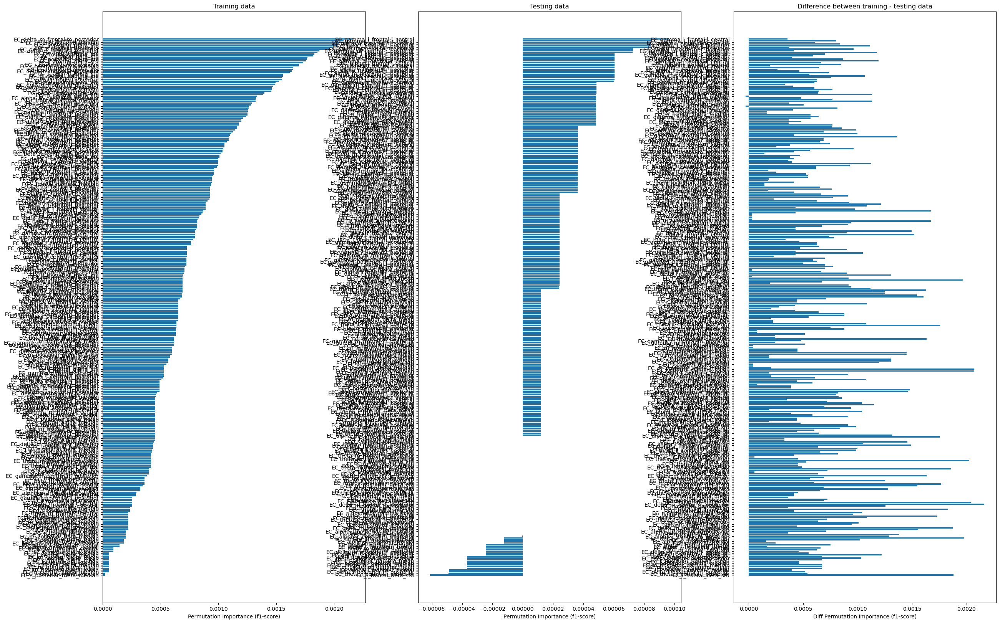

In [54]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EO feature set

In [55]:
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_eo.columns if 'EO' in num_col]
 
X = df_stat_conn_features_eo[numeric_cols]
Y = df_stat_conn_features_eo['diagnosis']
# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# hyperparameter ranges for GridSearch
param_grid = {
'rbf_svm__estimator__C': [0.01, 0.1, 1, 10, 100],
'rbf_svm__estimator__gamma': [0.1, 1, 10, 100],
'rbf_svm__estimator__kernel': ['rbf'],
'rbf_svm__estimator__class_weight': ['balanced']
}

# final pipeline
steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(class_weight = 'balanced')))]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

# define gridsearch
gridsearch = GridSearchCV(pipeline,
                        param_grid = param_grid,
                        cv = cv_inner, # use inner cv for hyperparameter tuning
                        scoring = f1_scorer,
                        error_score = 'raise',
                        return_train_score = True,
                        n_jobs=-1,
                        verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
gridsearch_fit = gridsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {gridsearch_fit.best_params_}')
print(f'Best f1-score: {gridsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
svm_test_score = cross_val_score(gridsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('SVM test scores:', svm_test_score)
print('Mean SVM test score:', np.mean(svm_test_score))
print('STD SVM test score:', np.std(svm_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best parameters: {'rbf_svm__estimator__C': 0.01, 'rbf_svm__estimator__class_weight': 'balanced', 'rbf_svm__estimator__gamma': 0.1, 'rbf_svm__estimator__kernel': 'rbf'}
Best f1-score: 0.15006288990535352


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
SVM test scores: [0.17970884 0.12733794 0.08235029 0.16327151 0.15185886]
Mean SVM test score: 0.14090548740216033
STD SVM test score: 0.033878325127674656


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.1min finished


In [56]:
with open("stat_conn_svm_eo.txt", "w") as output:
    output.write(str(np.mean(svm_test_score)))

{'C': 0.01, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   18.3s finished


f1_score: 0.15915532487297082

classification report:
               precision    recall  f1-score   support

        ADHD       0.35      0.18      0.24       540
     HEALTHY       0.11      0.02      0.03       540
         MDD       0.09      0.01      0.02       540
         OCD       0.49      0.08      0.13       540
         SMC       0.23      0.94      0.37       540

    accuracy                           0.25      2700
   macro avg       0.25      0.25      0.16      2700
weighted avg       0.25      0.25      0.16      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   18.3s finished


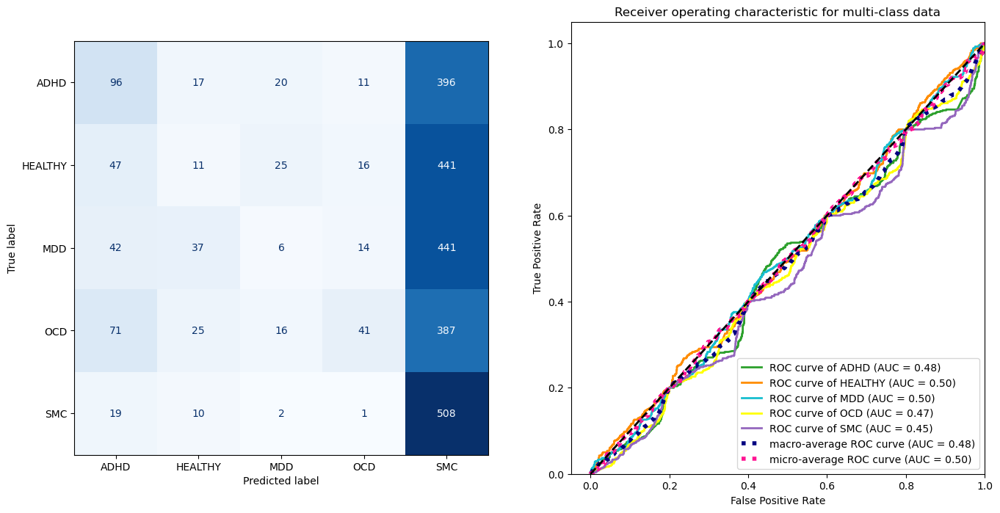

In [57]:
# final pipeline
best_params = {}
for hyperparameter in gridsearch.best_params_:
    key = hyperparameter[20:]
    best_params[key] = gridsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('rbf_svm', OneVsRestClassifier(SVC(**best_params, probability=True)))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 301), X_test.shape = (672, 301), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

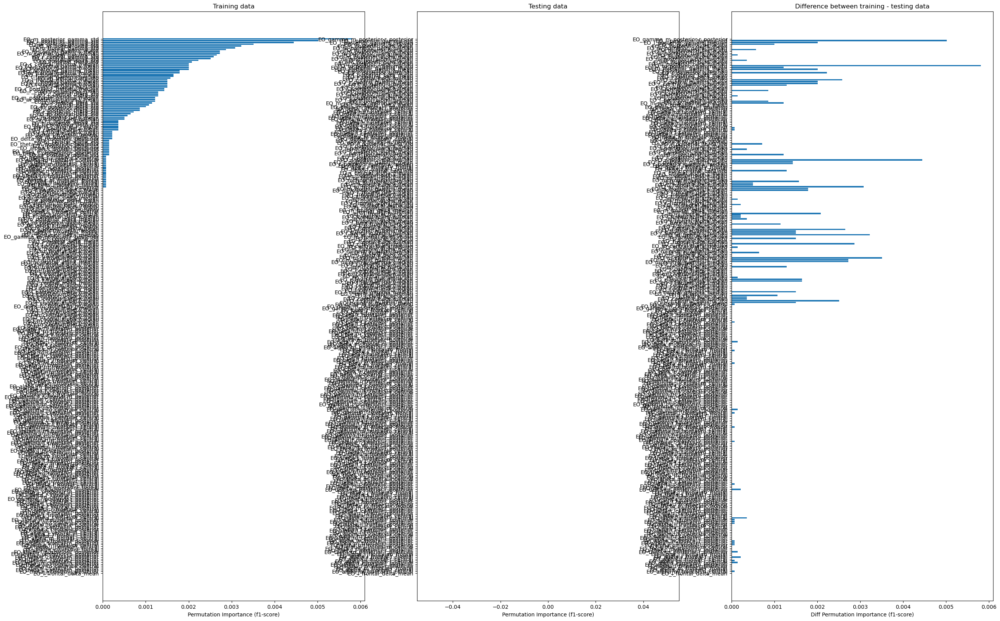

In [58]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

## Random Forest

#### ratio feature set

In [59]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_conn_features_ratio[numeric_cols]
Y = df_stat_conn_features_ratio['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
rf_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 fit_params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', rf_test_score)
print('Mean RF test score:', np.mean(rf_test_score))
print('STD RF test score:', np.std(rf_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best parameters: {'RF__n_estimators': 200, 'RF__min_samples_split': 10, 'RF__min_samples_leaf': 1, 'RF__max_features': 'sqrt', 'RF__max_depth': 90, 'RF__bootstrap': False}
Best f1-score: 0.2961709652559424


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.37210017 0.35662644 0.28449258 0.23838668 0.25238926]
Mean RF test score: 0.30079902723281904
STD RF test score: 0.05423146602986882


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 31.1min finished


In [60]:
with open("stat_conn_rf_ratio.txt", "w") as output:
    output.write(str(np.mean(rf_test_score)))

{'n_estimators': 200, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 90, 'bootstrap': False}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    9.0s finished


f1_score: 0.31708867829869003

classification report:
               precision    recall  f1-score   support

        ADHD       0.40      0.42      0.41       540
     HEALTHY       0.33      0.33      0.33       540
         MDD       0.25      0.23      0.24       540
         OCD       0.28      0.26      0.27       540
         SMC       0.32      0.34      0.33       540

    accuracy                           0.32      2700
   macro avg       0.32      0.32      0.32      2700
weighted avg       0.32      0.32      0.32      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    8.5s finished


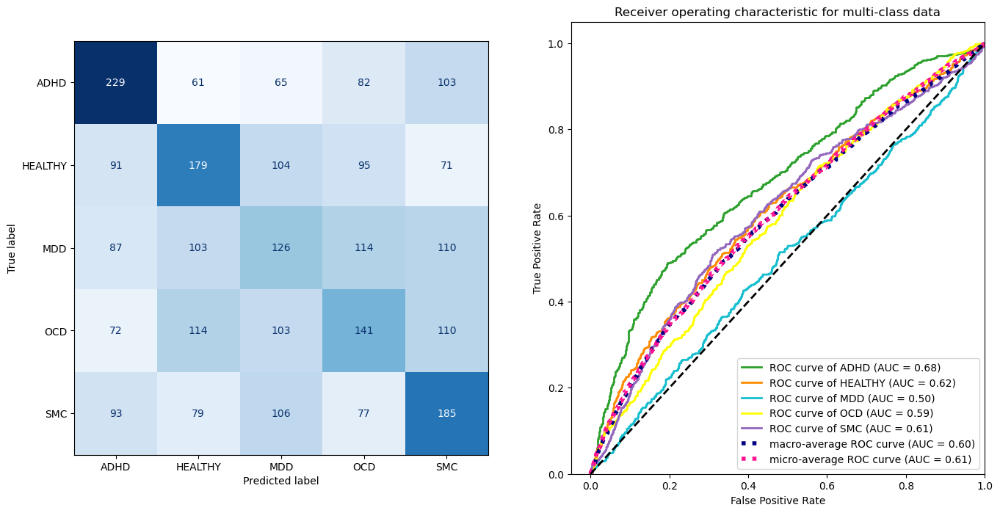

In [61]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[4:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 182), X_test.shape = (672, 182), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

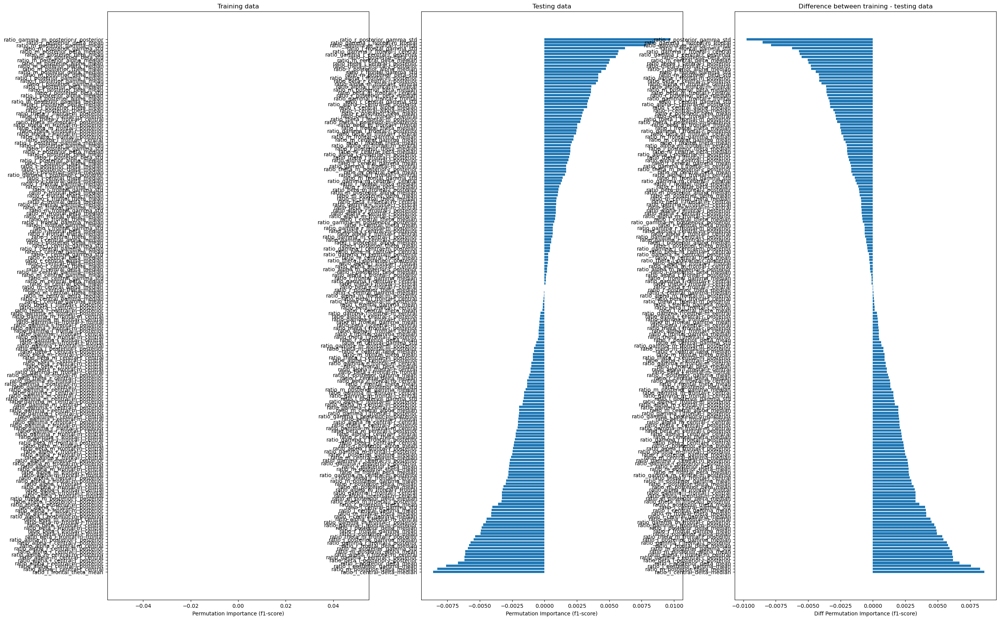

In [62]:
# using permutation_importance()
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EC feature set

In [63]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ec.columns if 'EC' in num_col]
 
X = df_stat_conn_features_ec[numeric_cols]
Y = df_stat_conn_features_ec['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
rf_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', rf_test_score)
print('Mean RF test score:', np.mean(rf_test_score))
print('STD RF test score:', np.std(rf_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters: {'RF__n_estimators': 1600, 'RF__min_samples_split': 10, 'RF__min_samples_leaf': 4, 'RF__max_features': 'log2', 'RF__max_depth': 30, 'RF__bootstrap': False}
Best f1-score: 0.37615570140919075


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value en

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.41393953 0.45621647 0.38517288 0.38327205 0.41867852]
Mean RF test score: 0.4114558931561098
STD RF test score: 0.026634450851381393


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 32.9min finished


In [64]:
with open("stat_conn_rf_ec.txt", "w") as output:
    output.write(str(np.mean(rf_test_score)))

{'n_estimators': 1600, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features': 'log2', 'max_depth': 30, 'bootstrap': False}
Fitting 3 folds for each of 100 candidates, totalling 300 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   33.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.


f1_score: 0.41230415876781384

classification report:
               precision    recall  f1-score   support

        ADHD       0.49      0.49      0.49       540
     HEALTHY       0.43      0.48      0.46       540
         MDD       0.37      0.32      0.34       540
         OCD       0.35      0.32      0.33       540
         SMC       0.42      0.46      0.44       540

    accuracy                           0.41      2700
   macro avg       0.41      0.41      0.41      2700
weighted avg       0.41      0.41      0.41      2700



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   32.4s finished


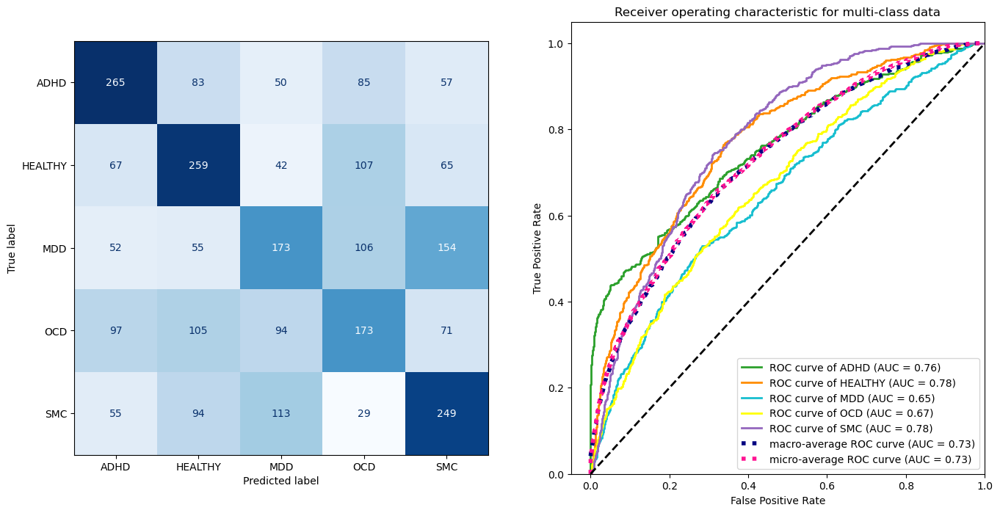

In [65]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[4:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 319), X_test.shape = (672, 319), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

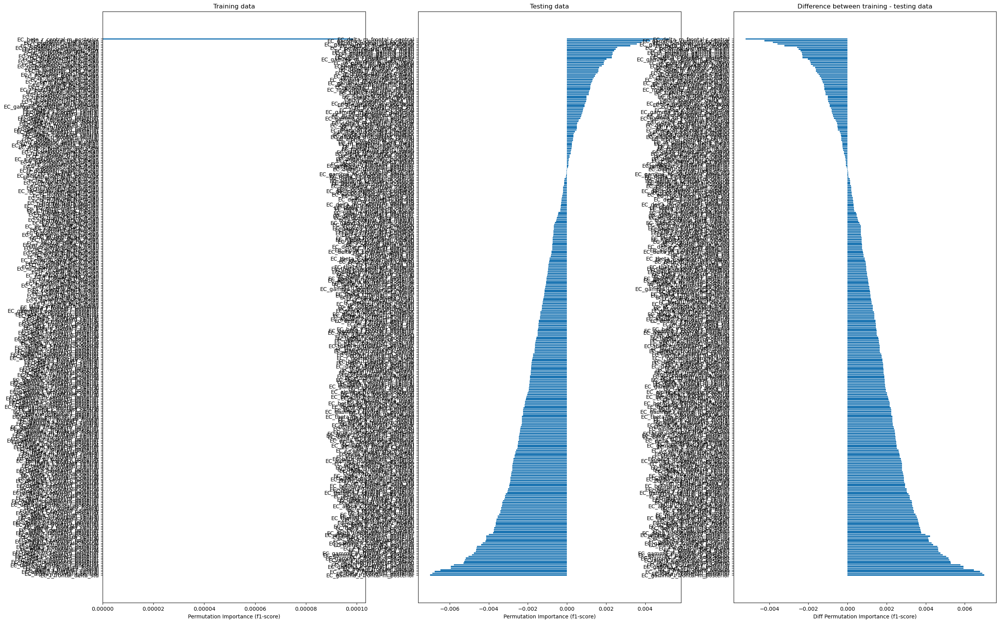

In [66]:
# using permutation_importance()
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EO feature set

In [67]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_eo.columns if 'EO' in num_col]

X = df_stat_conn_features_eo[numeric_cols]
Y = df_stat_conn_features_eo['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)

# final pipeline
steps = [('col_trans', col_trans), ('RF', RandomForestClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['log2', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'RF__n_estimators': n_estimators,
               'RF__max_features': max_features,
               'RF__max_depth': max_depth,
               'RF__min_samples_split': min_samples_split,
               'RF__min_samples_leaf': min_samples_leaf,
               'RF__bootstrap': bootstrap}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
rf_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('RF test scores:', rf_test_score)
print('Mean RF test score:', np.mean(rf_test_score))
print('STD RF test score:', np.std(rf_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits


/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Best parameters: {'RF__n_estimators': 600, 'RF__min_samples_split': 2, 'RF__min_samples_leaf': 4, 'RF__max_features': 'sqrt', 'RF__max_depth': 50, 'RF__bootstrap': True}
Best f1-score: 0.3652671631235285


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value en

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
RF test scores: [0.41509595 0.46847357 0.32928299 0.32949315 0.42518196]
Mean RF test score: 0.39350552655859794
STD RF test score: 0.055338718992479226


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 32.8min finished


In [68]:
with open("stat_conn_rf_eo.txt", "w") as output:
    output.write(str(np.mean(rf_test_score)))

{'n_estimators': 600, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_features': 'sqrt', 'max_depth': 50, 'bootstrap': True}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   16.2s finished


f1_score: 0.3923384866062606

classification report:
               precision    recall  f1-score   support

        ADHD       0.51      0.49      0.50       540
     HEALTHY       0.33      0.44      0.37       540
         MDD       0.24      0.19      0.21       540
         OCD       0.40      0.33      0.36       540
         SMC       0.49      0.55      0.51       540

    accuracy                           0.40      2700
   macro avg       0.39      0.40      0.39      2700
weighted avg       0.39      0.40      0.39      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   15.5s finished


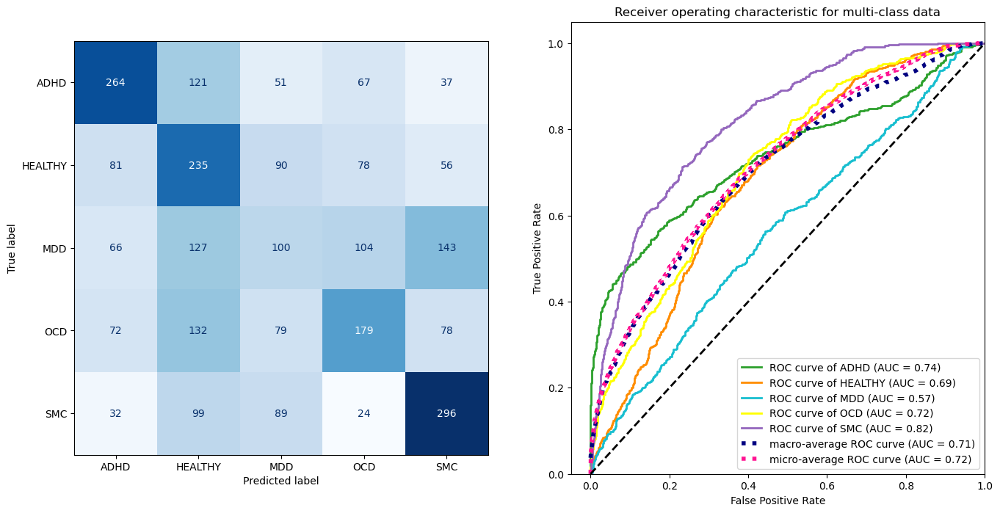

In [69]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[4:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('RF', RandomForestClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 301), X_test.shape = (672, 301), Y_train.shape = (2028,), Y_test.shape = (672,)


Text(0.5, 1.0, 'Difference between training - testing data')

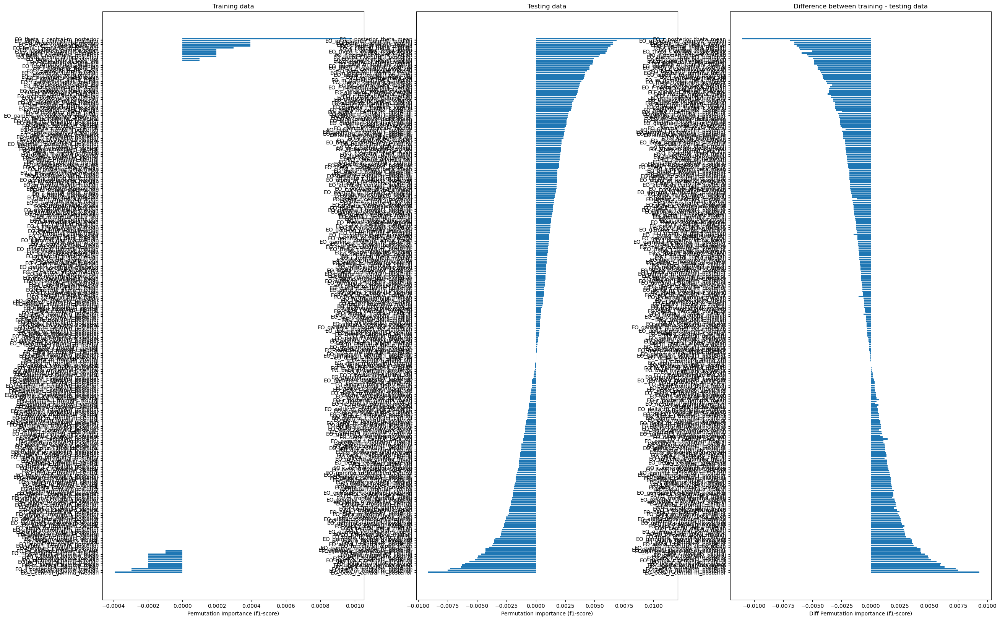

In [70]:
# using permutation_importance()
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

## GradientBoostingClassifier

#### ratio feature set

In [71]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ratio['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ratio.columns if 'ratio' in num_col]
 
X = df_stat_conn_features_ratio[numeric_cols]
Y = df_stat_conn_features_ratio['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
gbc_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', gbc_test_score)
print('Mean GBC test score:', np.mean(gbc_test_score))
print('STD GBC test score:', np.std(gbc_test_score))


# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters: {'gbc__subsample': 0.75, 'gbc__n_estimators': 700, 'gbc__min_samples_split': 5, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.030769316535942955, 'gbc__criterion': 'friedman_mse'}
Best f1-score: 0.2998238923820257


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2


GBC test scores: [0.35756802 0.33564071 0.31075503 0.22870956 0.30807117]
Mean GBC test score: 0.30814889716378663
STD GBC test score: 0.043624433608105015


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 162.9min finished


In [72]:
with open("stat_conn_gbc_ratio.txt", "w") as output:
    output.write(str(np.mean(gbc_test_score)))

{'subsample': 0.75, 'n_estimators': 700, 'min_samples_split': 5, 'loss': 'log_loss', 'learning_rate': 0.030769316535942955, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  5.8min finished


f1_score: 0.31103090941622424

classification report:
               precision    recall  f1-score   support

        ADHD       0.38      0.40      0.39       540
     HEALTHY       0.29      0.27      0.28       540
         MDD       0.25      0.27      0.26       540
         OCD       0.30      0.29      0.30       540
         SMC       0.34      0.33      0.33       540

    accuracy                           0.31      2700
   macro avg       0.31      0.31      0.31      2700
weighted avg       0.31      0.31      0.31      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  5.8min finished


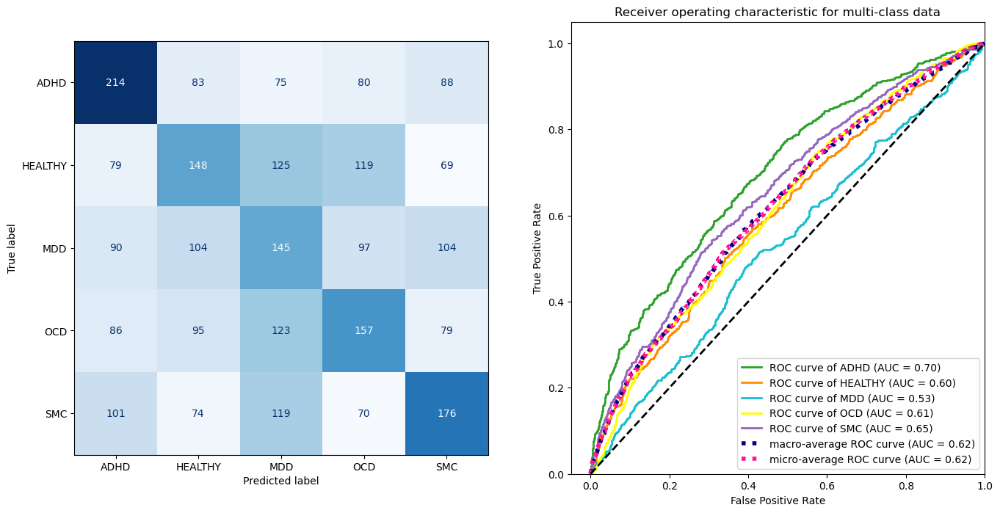

In [73]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[5:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 182), X_test.shape = (672, 182), Y_train.shape = (2028,), Y_test.shape = (672,)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits


Text(0.5, 1.0, 'Difference between training - testing data')

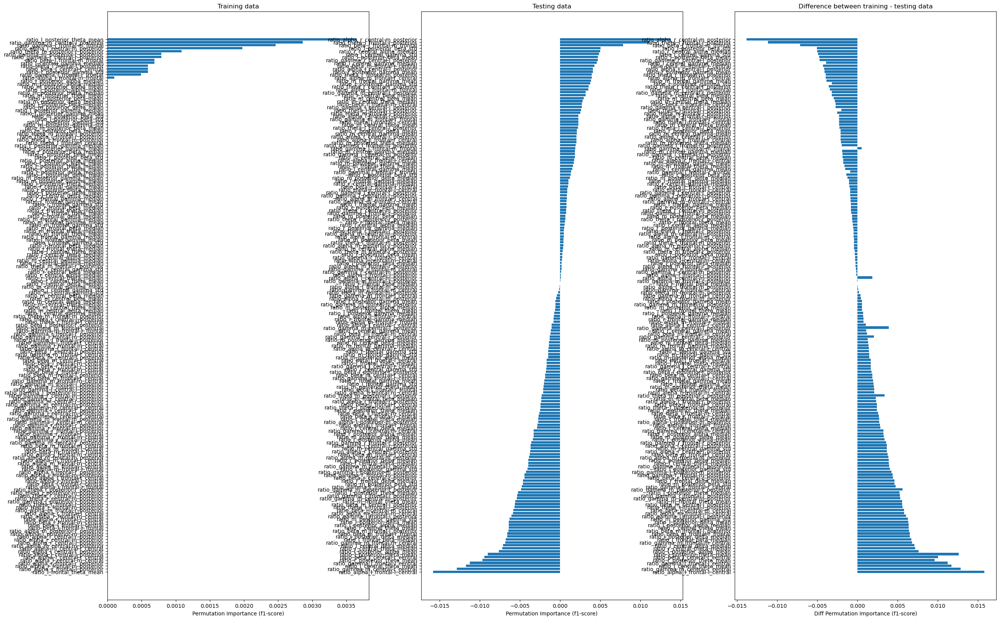

In [74]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EC feature set

In [75]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_ec['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_ec.columns if 'EC' in num_col]
 
X = df_stat_conn_features_ec[numeric_cols]
Y = df_stat_conn_features_ec['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
gbc_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', gbc_test_score)
print('Mean GBC test score:', np.mean(gbc_test_score))
print('STD GBC test score:', np.std(gbc_test_score))

# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters: {'gbc__subsample': 0.5, 'gbc__n_estimators': 900, 'gbc__min_samples_split': 2, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.02957437899694207, 'gbc__criterion': 'friedman_mse'}
Best f1-score: 0.39957708348029136


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value en

Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.46313711 0.5193516  0.36861747 0.40039425 0.44952021]
Mean GBC test score: 0.440204127809625
STD GBC test score: 0.05212774727194143


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 259.1min finished


In [76]:
with open("stat_conn_gbc_ec.txt", "w") as output:
    output.write(str(np.mean(gbc_test_score)))

{'subsample': 0.5, 'n_estimators': 900, 'min_samples_split': 2, 'loss': 'log_loss', 'learning_rate': 0.02957437899694207, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  8.5min finished


f1_score: 0.45200271998902836

classification report:
               precision    recall  f1-score   support

        ADHD       0.54      0.56      0.55       540
     HEALTHY       0.42      0.43      0.43       540
         MDD       0.37      0.36      0.36       540
         OCD       0.38      0.38      0.38       540
         SMC       0.55      0.54      0.55       540

    accuracy                           0.45      2700
   macro avg       0.45      0.45      0.45      2700
weighted avg       0.45      0.45      0.45      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  8.5min finished


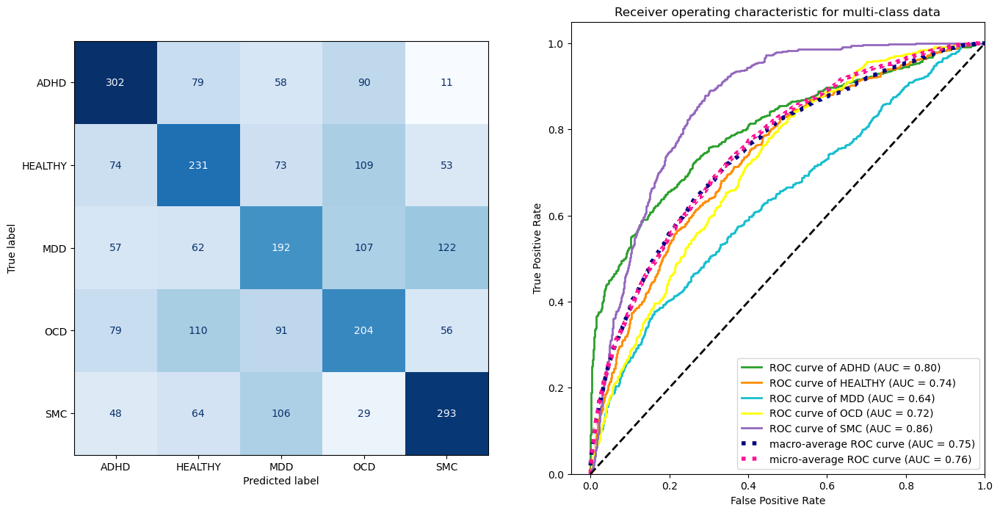

In [77]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[5:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 319), X_test.shape = (672, 319), Y_train.shape = (2028,), Y_test.shape = (672,)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits


Text(0.5, 1.0, 'Difference between training - testing data')

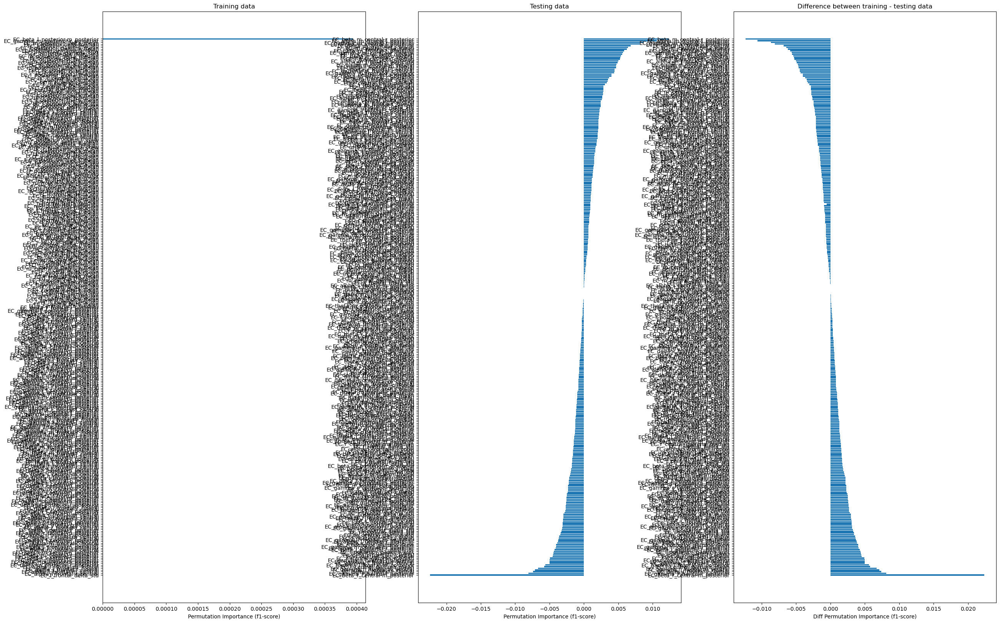

In [78]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')

#### EO feature set

In [79]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import StratifiedGroupKFold, GridSearchCV, GroupShuffleSplit, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import classification_report, confusion_matrix, f1_score, make_scorer, fbeta_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import GradientBoostingClassifier
from scipy.stats import loguniform


# assign groups (IDs) for GroupKFold
groups = df_stat_conn_features_eo['ID'].tolist()
print(f'# of instances: {len(groups)}')

# define numeric columns
numeric_cols = [num_col for num_col in df_stat_conn_features_eo.columns if 'EO' in num_col]
 
X = df_stat_conn_features_eo[numeric_cols]
Y = df_stat_conn_features_eo['diagnosis']

# label binarize diagnosis for ROC curve (alphabatic order by default)
# & label encode diagnosis for predictions
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
Y_one_hot = lb.fit_transform(Y)
print(Y_one_hot.shape)
le = preprocessing.LabelEncoder()
Y = le.fit_transform(Y)

# preprocessing steps for numerical features
numeric_transformer = Pipeline(steps = [
    ('scaler', StandardScaler()), # standardization
    ('impute', SimpleImputer(strategy='mean')) # mean imputation
])

col_trans = ColumnTransformer(transformers=[
    ('numeric_transformer', numeric_transformer, numeric_cols)
    ],
    remainder='drop',
    n_jobs=-1)


# final pipeline
steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier())]
pipeline = Pipeline(steps)

# define score metric
f1_scorer = make_scorer(fbeta_score, beta=1, average='weighted')

# define inner & outer CV objects
cv_inner = StratifiedGroupKFold(n_splits = 3, shuffle=False) # shuffle=False, so splits will be the same across calls (?)
cv_outer = StratifiedGroupKFold(n_splits = 5, shuffle=False) # shuffle=False, so splits will be the same across calls (?)

## Hyperparameters for RandomizedSearchCV
# Number of boosting stages to perform
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# Loss function to be optimized
loss = ['log_loss']
# Learning rate
learning_rate = loguniform.rvs(0.001, 0.1, size=1000)
# Fraction of samples to be used for fitting the individual base learners
subsample = [x for x in np.linspace(0.5, 1, 5)]
# The function to measure the quality of the split
criterion = ['friedman_mse']
# The min number of samples required to split an internal node
min_samples_split = [2, 5, 10]
# Create the random grid
random_grid = {'gbc__n_estimators': n_estimators,
               'gbc__loss': loss,
               'gbc__learning_rate': learning_rate,
               'gbc__subsample': subsample,
               'gbc__criterion': criterion,
               'gbc__min_samples_split': min_samples_split}

# define randomized search
randsearch = RandomizedSearchCV(pipeline,
                                param_distributions=random_grid,
                                n_iter=100, # 100
                                cv = cv_inner, # use inner cv for hyperparameter tuning
                                scoring = f1_scorer,
                                error_score = 'raise',
                                return_train_score = True,
                                n_jobs=-1,
                                verbose=1)

# non-nested CV for obtaining the propable best hyperparameters
randsearch_fit = randsearch.fit(X, Y, groups = groups)
print(f'Best parameters: {randsearch_fit.best_params_}')
print(f'Best f1-score: {randsearch_fit.best_score_}')

# nested CV with parameter optimization to compute testing score (f1-score)
gbc_test_score = cross_val_score(randsearch, # use unfitted gridsearch object, (idk if this matters)
                                 X = X, y = Y, 
                                 cv = cv_outer, # use outer cv for model evaluation
                                 groups = groups, 
                                 params={"groups": groups},
                                 scoring = f1_scorer,
                                 error_score = 'raise',
                                 verbose=1,
                                 n_jobs=-1)
print('GBC test scores:', gbc_test_score)
print('Mean GBC test score:', np.mean(gbc_test_score))
print('STD GBC test score:', np.std(gbc_test_score))

# of instances: 2700
(2700, 5)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters: {'gbc__subsample': 1.0, 'gbc__n_estimators': 300, 'gbc__min_samples_split': 5, 'gbc__loss': 'log_loss', 'gbc__learning_rate': 0.039247831315541874, 'gbc__criterion': 'friedman_mse'}
Best f1-score: 0.3915054174734513


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/sklearn/utils/extmath.py:1144: RuntimeWarning: invalid value encountered in divide
  * (last_sum / last_over_new_count - new_sum) ** 2


Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits
GBC test scores: [0.44315289 0.43689269 0.34628735 0.33241512 0.45339932]
Mean GBC test score: 0.4024294730388974
STD GBC test score: 0.05195764183409518


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 270.2min finished


In [80]:
with open("stat_conn_gbc_eo.txt", "w") as output:
    output.write(str(np.mean(gbc_test_score)))

{'subsample': 1.0, 'n_estimators': 300, 'min_samples_split': 5, 'loss': 'log_loss', 'learning_rate': 0.039247831315541874, 'criterion': 'friedman_mse'}


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  5.6min finished


f1_score: 0.4091363912590168

classification report:
               precision    recall  f1-score   support

        ADHD       0.47      0.47      0.47       540
     HEALTHY       0.35      0.36      0.35       540
         MDD       0.25      0.27      0.26       540
         OCD       0.43      0.41      0.42       540
         SMC       0.55      0.53      0.54       540

    accuracy                           0.41      2700
   macro avg       0.41      0.41      0.41      2700
weighted avg       0.41      0.41      0.41      2700



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 30 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  5.6min finished


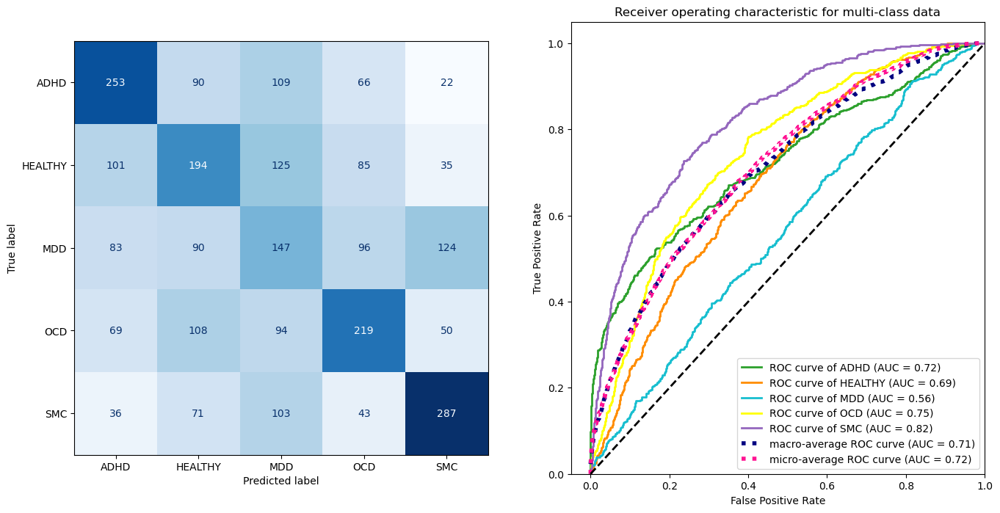

In [81]:
# final pipeline
best_params = {}
for hyperparameter in randsearch.best_params_:
    key = hyperparameter[5:]
    best_params[key] = randsearch.best_params_[hyperparameter]
print(best_params)

steps = [('col_trans', col_trans), ('gbc', GradientBoostingClassifier(**best_params))]
pipeline = Pipeline(steps)

# obtain predictions
Y_pred = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1)    
class_labels = le.inverse_transform(sorted(np.unique(Y)))
print('f1_score:', f1_score(Y, Y_pred, average = 'weighted', zero_division=0))
print()
print('classification report:\n', classification_report(Y, Y_pred, target_names=class_labels, zero_division=0))

# create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
conf_matrix = confusion_matrix(Y, Y_pred)
ConfusionMatrixDisplay(conf_matrix, display_labels = class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False, ax=ax1)

# obtain proba predictions
Y_score = cross_val_predict(pipeline, X, Y,  cv = cv_outer, groups = groups, n_jobs=-1, verbose=1, method='predict_proba')

### plot ROC curves
from sklearn.metrics import roc_curve, auc
n_classes = Y_one_hot.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()
lw=2


for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_one_hot[:, i], Y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['tab:green', 'darkorange', 'tab:cyan', 'yellow', 'tab:purple']
for i, color in zip(range(n_classes), colors):
    ax2.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of {class_labels[i]} (AUC = {roc_auc[i]:0.2f})')
    
## Compute macro-average ROC curve and AUC
fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
ax2.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)    
## Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(Y_one_hot.ravel(), Y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
ax2.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)


ax2.plot([0, 1], [0, 1], 'k--', lw=lw)
ax2.set_xlim([-0.05, 1.0])
ax2.set_ylim([0.0, 1.05])
ax2.set_xlabel('False Positive Rate')
ax2.set_ylabel('True Positive Rate')
ax2.set_title('Receiver operating characteristic for multi-class data')
ax2.legend(loc="lower right")
plt.show()

Checking feature importance

len(X) = 2700
X_train.shape = (2028, 301), X_test.shape = (672, 301), Y_train.shape = (2028,), Y_test.shape = (672,)
Fitting 3 folds for each of 100 candidates, totalling 300 fits
Fitting 3 folds for each of 100 candidates, totalling 300 fits


Text(0.5, 1.0, 'Difference between training - testing data')

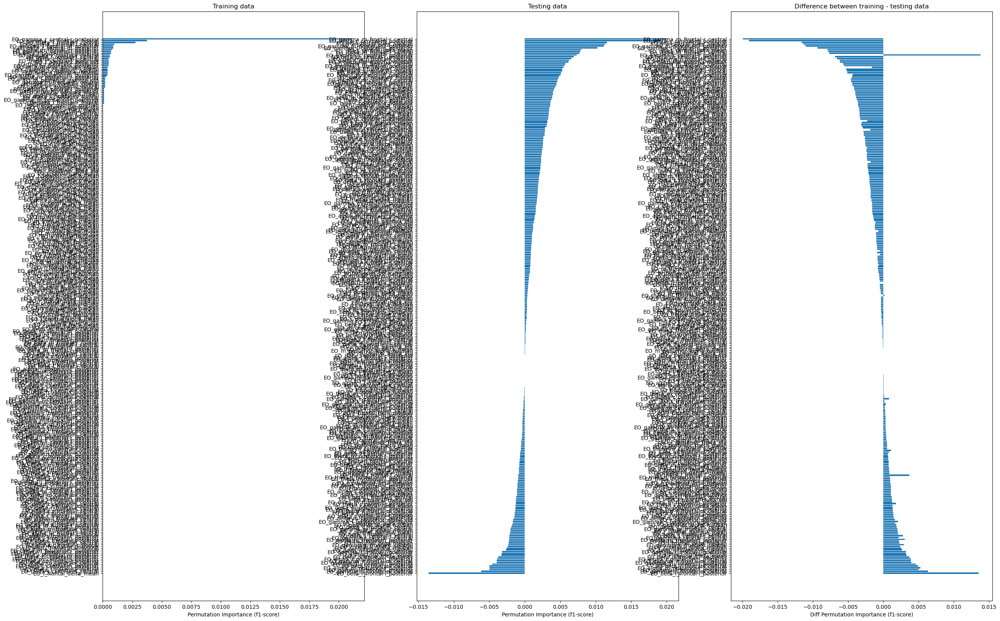

In [82]:
# using permutation_importance(), but according to literature it isn't a very reliable method for SVC with rbf kernel
from sklearn.inspection import permutation_importance

# splitting data into train and test set
desired_test_ratio = 0.25
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)
train_idxs, test_idxs = sgkf.split(X, Y, groups).__next__() # just take the first split
print(f'{len(X) = }')

X_train = X.iloc[train_idxs]
X_test = X.iloc[test_idxs]
Y_train = Y[train_idxs]
Y_test = Y[test_idxs]
print(f'{X_train.shape = }, {X_test.shape = }, {Y_train.shape = }, {Y_test.shape = }')

# fit pipeline to training data
pipeline_fit = pipeline.fit(X_train, Y_train)
train_perm_importance = permutation_importance(pipeline_fit, X_train, Y_train,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

train_sorted_idx = train_perm_importance.importances_mean.argsort()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 20))
ax1.barh(X.columns[train_sorted_idx], train_perm_importance.importances_mean[train_sorted_idx])
ax1.set_xlabel("Permutation Importance (f1-score)")
ax1.set_title('Training data')

# fit pipeline to test data
test_perm_importance = permutation_importance(pipeline_fit, X_test, Y_test,
                                    n_repeats=5, random_state=42,
                                    n_jobs=-1, scoring=f1_scorer)

test_sorted_idx = test_perm_importance.importances_mean.argsort()
ax2.barh(X.columns[test_sorted_idx], test_perm_importance.importances_mean[test_sorted_idx])
ax2.set_xlabel("Permutation Importance (f1-score)")
ax2.set_title('Testing data')

# plot difference between training and testing permutation importance (im not entirely
# sure if the indices are the same for both test/train data, as the importances_mean attribute is just a numpy array)
diff = train_perm_importance.importances_mean - test_perm_importance.importances_mean
ax3.barh(X.columns[test_sorted_idx], diff[test_sorted_idx])
ax3.set_xlabel("Diff Permutation Importance (f1-score)")
ax3.set_title('Difference between training - testing data')